# 1 Setup

## 1.1 Import some great packages


In [216]:
!conda --version # should return 4.5.4

conda 4.10.1


In [217]:
pwd

'C:\\Users\\trevo\\Data for Datathon'

In [218]:
import pandas as pd
import numpy as np
import seaborn as sns
#progress bar
from tqdm.notebook import tqdm
from pandas_profiling import ProfileReport
import matplotlib.pyplot as plt

In [219]:
#!pip install geovoronoi

In [220]:
#!pip install geopandas==0.8.0
#conda install geopandas

In [221]:
#import geopandas as gpd

#from geovoronoi.plotting import subplot_for_map, plot_voronoi_polys_with_points_in_area
#from geovoronoi import voronoi_regions_from_coords, points_to_coords

## 1.2 Load the data from organizer Google drive

In [222]:
#def folder_download(folder_id):
  # authenticate
 # from google.colab import auth
 # auth.authenticate_user()
  # get folder_name
#  from googleapiclient.discovery import build
#  service = build('drive', 'v3')
#  folder_name = service.files().get(fileId=folder_id).execute()['name']
  # import library and download
#  !wget -qnc https://github.com/segnolin/google-drive-folder-downloader/raw/master/download.py
#  from download import download_folder
#  download_folder(service, folder_id, './', folder_name)
#  return folder_name

#folder_download('1g58xFQ9aDcTPetma4blzVTQYX-QKkzNf')

In [223]:
# unzip some files
#!mkdir clean_las_files
#! cd C:\\Users\\trevo\\Data for Datathon && unzip well_log_files.zip -d /content/clean_las_files

#import zipfile
#with zipfile.ZipFile('C:\\Users\\trevo\\Data for Datathon', 'r') as zip_ref:
#    zip_ref.extractall('C:\\Users\\trevo\\Data for Datathon\clean_las_files')

In [224]:
# set paths of different subdirectories
dir_eaglebine = 'C:\\Users\\trevo\\Data for Datathon/Eaglebine/Eaglebine/'
dir_duvernay = 'C:\\Users\\trevo\\Data for Datathon/Duvernay/Duvernay/'

# 2 Organize Eaglebine temperature data

## 2.1 read in BHT

In [225]:
Eaglebine_BHT = pd.read_excel(dir_eaglebine+'Eaglebine BHT TSC data for SPE April 21 2020.xlsx')
Eaglebine_BHT['TempC_BHT'] = (Eaglebine_BHT['BHTorMRT (maximum recorded temperature) oF'] - 32) * (5./9.)
Eaglebine_BHT.head()

,UWI,SurfLat,SurfLong,TD (ft),GL(ft),BHT_below sea level (ft),BHT_ subsurface (ft),BHTorMRT (maximum recorded temperature) oF,TSC or ORT (time since circulation or original recorded time in hours),TempC_BHT
0,42013301410000,28.690426,-98.470138,19629.0,345.90,12222.50,12568.4,143.0,5.50,61.666667
1,42013301930000,28.779921,-98.208313,10775.0,397.40,10396.00,10793.4,225.0,11.00,107.222222
2,42013302760000,28.994360,-98.421799,6168.0,460.40,5733.00,6193.4,150.0,5.50,65.555556
3,42013305480000,28.759118,-98.156410,8198.0,410.40,7806.00,8216.4,170.0,5.00,76.666667
4,42013310190000,28.817400,-98.155319,11000.0,508.92,10509.48,11018.4,210.0,7.75,98.888889


In [226]:
print("number of unique wells: " + str(len(pd.unique(Eaglebine_BHT['UWI']))))

number of unique wells: 324


In [227]:
Eaglebine_BHT.isna().sum()

UWI                                                                       0
SurfLat                                                                   0
SurfLong                                                                  0
TD (ft)                                                                   0
GL(ft)                                                                    0
BHT_below sea level (ft)                                                  0
BHT_ subsurface (ft)                                                      0
BHTorMRT (maximum recorded temperature) oF                                0
TSC or ORT (time since circulation or original recorded time in hours)    0
TempC_BHT                                                                 0
dtype: int64

## 2.2 Read in Eaglebine synthetic "true formation temperature"

In [228]:
Eaglebine_Truth = pd.read_excel(dir_eaglebine+'Eaglebine TrueTemp_Train2.xlsx')
Eaglebine_Truth.head()

,UWI,Depth sub-sea (feet),True Temperature (oF)
0,42013301410000,-350,70.33
1,42013301410000,-300,70.33
2,42013301410000,-250,70.33
3,42013301410000,-200,71.49
4,42013301410000,-150,72.66


In [229]:
# convert to Celsius
Eaglebine_Truth['TempTrue_degC'] = (Eaglebine_Truth['True Temperature   (oF)'] - 32) * (5./9.)
Eaglebine_Truth.head()

,UWI,Depth sub-sea (feet),True Temperature (oF),TempTrue_degC
0,42013301410000,-350,70.33,21.294444
1,42013301410000,-300,70.33,21.294444
2,42013301410000,-250,70.33,21.294444
3,42013301410000,-200,71.49,21.938889
4,42013301410000,-150,72.66,22.588889


In [230]:
print("number of unique wells in Eaglebine in training set: " + str(len(pd.unique(Eaglebine_Truth['UWI']))))

number of unique wells in Eaglebine in training set: 243


In [231]:
# gradients eb
GL=Eaglebine_BHT[['UWI','GL(ft)']]

eb_Truegrad=Eaglebine_Truth.merge(GL, left_on='UWI', right_on='UWI', how='left')
eb_Truegrad['md (m)']= (eb_Truegrad['Depth sub-sea (feet)']+eb_Truegrad['GL(ft)'])*.3048
eb_Truegrad['Gradient True degC/100m'] = eb_Truegrad['TempTrue_degC']/eb_Truegrad['md (m)']*100

eb_Truegrad=eb_Truegrad.drop(eb_Truegrad[eb_Truegrad['md (m)']<=250].index)
eb_Truegrad=eb_Truegrad.drop(eb_Truegrad[eb_Truegrad['TempTrue_degC']<=50].index)

eb_Truegrad.head()

,UWI,Depth sub-sea (feet),True Temperature (oF),TempTrue_degC,GL(ft),md (m),Gradient True degC/100m
52,42013301410000,2250,122.68,50.377778,345.9,791.23032,6.367018
53,42013301410000,2300,123.62,50.900000,345.9,806.47032,6.311454
54,42013301410000,2350,124.56,51.422222,345.9,821.71032,6.257950
55,42013301410000,2400,125.50,51.944444,345.9,836.95032,6.206395
56,42013301410000,2450,126.45,52.472222,345.9,852.19032,6.157336


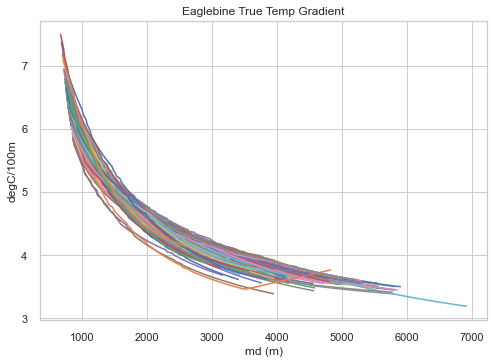

In [232]:
fig, ax = plt.subplots()

for key, grp in eb_Truegrad.groupby('UWI'):
    ax = grp.plot(x = 'md (m)', y = 'Gradient True degC/100m',ax = ax, kind='line',legend=False)
    plt.ylabel('degC/100m')
    plt.title('Eaglebine True Temp Gradient')
    

SMALL_SIZE = 12
MEDIUM_SIZE = 15
BIGGER_SIZE = 20

plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
plt.rc('axes', titlesize=BIGGER_SIZE)     # fontsize of the axes title
plt.rc('axes', labelsize=MEDIUM_SIZE)    # fontsize of the x and y labels
plt.rc('xtick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('ytick', labelsize=SMALL_SIZE)    # fontsize of the tick labels
plt.rc('legend', fontsize=MEDIUM_SIZE)    # legend fontsize
plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title

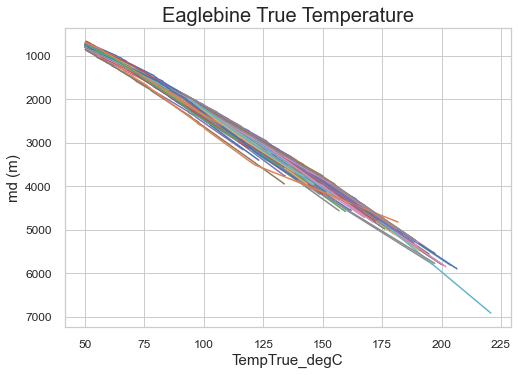

In [233]:
fig, ax = plt.subplots()
for key, grp in eb_Truegrad.groupby('UWI'):
    ax = grp.plot(y = 'md (m)', x = 'TempTrue_degC',ax = ax, kind='line',legend=False)
    plt.ylabel('md (m)')
    plt.title('Eaglebine True Temperature')

    plt.gca().invert_yaxis()

## 2.3 Combine measured BHT and true temperature

In [234]:
Eaglebine_Combined = Eaglebine_BHT.merge(Eaglebine_Truth, on='UWI', how='left')
Eaglebine_Combined.head()

,UWI,SurfLat,SurfLong,TD (ft),GL(ft),BHT_below sea level (ft),BHT_ subsurface (ft),BHTorMRT (maximum recorded temperature) oF,TSC or ORT (time since circulation or original recorded time in hours),TempC_BHT,Depth sub-sea (feet),True Temperature (oF),TempTrue_degC
0,42013301410000,28.690426,-98.470138,19629.0,345.9,12222.5,12568.4,143.0,5.5,61.666667,-350.0,70.33,21.294444
1,42013301410000,28.690426,-98.470138,19629.0,345.9,12222.5,12568.4,143.0,5.5,61.666667,-300.0,70.33,21.294444
2,42013301410000,28.690426,-98.470138,19629.0,345.9,12222.5,12568.4,143.0,5.5,61.666667,-250.0,70.33,21.294444
3,42013301410000,28.690426,-98.470138,19629.0,345.9,12222.5,12568.4,143.0,5.5,61.666667,-200.0,71.49,21.938889
4,42013301410000,28.690426,-98.470138,19629.0,345.9,12222.5,12568.4,143.0,5.5,61.666667,-150.0,72.66,22.588889


In [235]:
Eaglebine_Combined.isna().sum()

UWI                                                                        0
SurfLat                                                                    0
SurfLong                                                                   0
TD (ft)                                                                    0
GL(ft)                                                                     0
BHT_below sea level (ft)                                                   0
BHT_ subsurface (ft)                                                       0
BHTorMRT (maximum recorded temperature) oF                                 0
TSC or ORT (time since circulation or original recorded time in hours)     0
TempC_BHT                                                                  0
Depth sub-sea (feet)                                                      81
True Temperature   (oF)                                                   81
TempTrue_degC                                                             81

In [236]:
# only keep from the synthetic data, the temperature at the elevation closest to the model
Eaglebine_Combined['diff_depth'] = Eaglebine_Combined['Depth sub-sea (feet)']-Eaglebine_Combined['BHT_below sea level (ft)']
Eaglebine_Combined['diff_depth_abs'] = np.abs(Eaglebine_Combined['diff_depth'])
idx = Eaglebine_Combined.groupby(['UWI'])['diff_depth_abs'].transform(min) == Eaglebine_Combined['diff_depth_abs']
TrueTempUWI = Eaglebine_Combined.loc[idx, ['UWI', 'diff_depth_abs', 'TempTrue_degC','Depth sub-sea (feet)']]
TrueTempUWI = TrueTempUWI.copy(deep=True)
Eaglebine_Combined_cln = Eaglebine_BHT.merge(TrueTempUWI, on='UWI', how='left')
Eaglebine_Combined_cln.head()

,UWI,SurfLat,SurfLong,TD (ft),GL(ft),BHT_below sea level (ft),BHT_ subsurface (ft),BHTorMRT (maximum recorded temperature) oF,TSC or ORT (time since circulation or original recorded time in hours),TempC_BHT,diff_depth_abs,TempTrue_degC,Depth sub-sea (feet)
0,42013301410000,28.690426,-98.470138,19629.0,345.90,12222.50,12568.4,143.0,5.50,61.666667,22.50,141.555556,12200.0
1,42013301930000,28.779921,-98.208313,10775.0,397.40,10396.00,10793.4,225.0,11.00,107.222222,4.00,132.038889,10400.0
2,42013302760000,28.994360,-98.421799,6168.0,460.40,5733.00,6193.4,150.0,5.50,65.555556,17.00,89.161111,5750.0
3,42013305480000,28.759118,-98.156410,8198.0,410.40,7806.00,8216.4,170.0,5.00,76.666667,6.00,107.961111,7800.0
4,42013310190000,28.817400,-98.155319,11000.0,508.92,10509.48,11018.4,210.0,7.75,98.888889,9.48,133.722222,10500.0


In [237]:
len(Eaglebine_Combined_cln)

324

In [238]:
Eaglebine_Combined_cln.isna().sum()

UWI                                                                        0
SurfLat                                                                    0
SurfLong                                                                   0
TD (ft)                                                                    0
GL(ft)                                                                     0
BHT_below sea level (ft)                                                   0
BHT_ subsurface (ft)                                                       0
BHTorMRT (maximum recorded temperature) oF                                 0
TSC or ORT (time since circulation or original recorded time in hours)     0
TempC_BHT                                                                  0
diff_depth_abs                                                            81
TempTrue_degC                                                             81
Depth sub-sea (feet)                                                      81

## 2.4 Read in static temperature information and merge into dataset

In [239]:
pwd

'C:\\Users\\trevo\\Data for Datathon'

In [240]:
Static_log_temp = pd.read_csv('C:\\Users\\trevo\\Data for Datathon/Data_static_logs.csv')
Static_log_temp.head()

,Well_ID,Depth (ft),Temp (degC),Field
0,42013301930000,10700.0,132.778000,Eaglebine
1,42041305800000,7360.0,82.777778,Eaglebine
2,42041311700000,7828.0,118.888889,Eaglebine
3,42041311980000,7954.0,105.000000,Eaglebine
4,42051305380000,8380.0,111.111111,Eaglebine


In [241]:
Static_log_temp.shape

(41, 4)

In [242]:
Eaglebine_Combined_cln['UWI'] = Eaglebine_Combined_cln['UWI'].astype(str)
Eaglebine_Combined_cln = Eaglebine_Combined_cln.copy(deep=True)
Eaglebine_Combined_cln['TrueTemp_datasource_syn'] = 'synthetic'
Static_log_temp['TrueTemp_datasource_stat'] = 'static_temp_logs'
Eaglebine_Combined_stat = Eaglebine_Combined_cln.merge(Static_log_temp, left_on='UWI',right_on='Well_ID', how='left')

In [243]:
Eaglebine_Combined_stat.shape

(324, 19)

In [244]:
# Coalesce columns together with priority for true temperature measurements
Eaglebine_Combined_stat['TempC_Fin'] = Eaglebine_Combined_stat['Temp (degC)'].fillna(Eaglebine_Combined_stat['TempTrue_degC'])
Eaglebine_Combined_stat['TrueTemp_datasource'] = Eaglebine_Combined_stat['TrueTemp_datasource_stat'].fillna(Eaglebine_Combined_stat['TrueTemp_datasource_syn'])
Eaglebine_Combined_stat.head()

,UWI,SurfLat,SurfLong,TD (ft),GL(ft),BHT_below sea level (ft),BHT_ subsurface (ft),BHTorMRT (maximum recorded temperature) oF,TSC or ORT (time since circulation or original recorded time in hours),TempC_BHT,...,TempTrue_degC,Depth sub-sea (feet),TrueTemp_datasource_syn,Well_ID,Depth (ft),Temp (degC),Field,TrueTemp_datasource_stat,TempC_Fin,TrueTemp_datasource
0,42013301410000,28.690426,-98.470138,19629.0,345.90,12222.50,12568.4,143.0,5.50,61.666667,...,141.555556,12200.0,synthetic,NaN,NaN,NaN,NaN,NaN,141.555556,synthetic
1,42013301930000,28.779921,-98.208313,10775.0,397.40,10396.00,10793.4,225.0,11.00,107.222222,...,132.038889,10400.0,synthetic,42013301930000,10700.0,132.778,Eaglebine,static_temp_logs,132.778000,static_temp_logs
2,42013302760000,28.994360,-98.421799,6168.0,460.40,5733.00,6193.4,150.0,5.50,65.555556,...,89.161111,5750.0,synthetic,NaN,NaN,NaN,NaN,NaN,89.161111,synthetic
3,42013305480000,28.759118,-98.156410,8198.0,410.40,7806.00,8216.4,170.0,5.00,76.666667,...,107.961111,7800.0,synthetic,NaN,NaN,NaN,NaN,NaN,107.961111,synthetic
4,42013310190000,28.817400,-98.155319,11000.0,508.92,10509.48,11018.4,210.0,7.75,98.888889,...,133.722222,10500.0,synthetic,NaN,NaN,NaN,NaN,NaN,133.722222,synthetic


In [245]:
Eaglebine_Combined_stat['BHT_ subsurface (m)']=Eaglebine_Combined_stat['BHT_ subsurface (ft)']*.3048
Eaglebine_Combined_stat['Depth_SS(m)']=Eaglebine_Combined_stat['BHT_below sea level (ft)']*.3048
Eaglebine_Combined_stat['diff_depth_abs (m)']=Eaglebine_Combined_stat['diff_depth_abs']*.3048
Eaglebine_Combined_stat['diff_depth (m)']=(Eaglebine_Combined_stat['BHT_below sea level (ft)']-Eaglebine_Combined_stat['Depth sub-sea (feet)'])*.3048
Eaglebine_Combined_stat['Gradient True (deg C/100 m)']=Eaglebine_Combined_stat['TempC_Fin']/Eaglebine_Combined_stat['Depth_SS(m)']*100
Eaglebine_Combined_stat['Gradient BHT (deg C/100 m)']=Eaglebine_Combined_stat['TempC_BHT']/Eaglebine_Combined_stat['BHT_ subsurface (m)']*100
Eaglebine_Combined_stat.head()

,UWI,SurfLat,SurfLong,TD (ft),GL(ft),BHT_below sea level (ft),BHT_ subsurface (ft),BHTorMRT (maximum recorded temperature) oF,TSC or ORT (time since circulation or original recorded time in hours),TempC_BHT,...,Field,TrueTemp_datasource_stat,TempC_Fin,TrueTemp_datasource,BHT_ subsurface (m),Depth_SS(m),diff_depth_abs (m),diff_depth (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m)
0,42013301410000,28.690426,-98.470138,19629.0,345.90,12222.50,12568.4,143.0,5.50,61.666667,...,NaN,NaN,141.555556,synthetic,3830.84832,3725.418000,6.858000,6.858000,3.799723,1.609739
1,42013301930000,28.779921,-98.208313,10775.0,397.40,10396.00,10793.4,225.0,11.00,107.222222,...,Eaglebine,static_temp_logs,132.778000,static_temp_logs,3289.82832,3168.700800,1.219200,-1.219200,4.190298,3.259204
2,42013302760000,28.994360,-98.421799,6168.0,460.40,5733.00,6193.4,150.0,5.50,65.555556,...,NaN,NaN,89.161111,synthetic,1887.74832,1747.418400,5.181600,-5.181600,5.102448,3.472685
3,42013305480000,28.759118,-98.156410,8198.0,410.40,7806.00,8216.4,170.0,5.00,76.666667,...,NaN,NaN,107.961111,synthetic,2504.35872,2379.268800,1.828800,1.828800,4.537575,3.061329
4,42013310190000,28.817400,-98.155319,11000.0,508.92,10509.48,11018.4,210.0,7.75,98.888889,...,NaN,NaN,133.722222,synthetic,3358.40832,3203.289504,2.889504,2.889504,4.174528,2.944517


In [246]:
Eaglebine_Combined_stat.to_csv('StructuredData/Eaglebine_Combined_stat.csv')

Eaglebine_Combined_stat.isna().sum()

UWI                                                                         0
SurfLat                                                                     0
SurfLong                                                                    0
TD (ft)                                                                     0
GL(ft)                                                                      0
BHT_below sea level (ft)                                                    0
BHT_ subsurface (ft)                                                        0
BHTorMRT (maximum recorded temperature) oF                                  0
TSC or ORT (time since circulation or original recorded time in hours)      0
TempC_BHT                                                                   0
diff_depth_abs                                                             81
TempTrue_degC                                                              81
Depth sub-sea (feet)                                            

## 2.5 plot the eaglebine temperature data

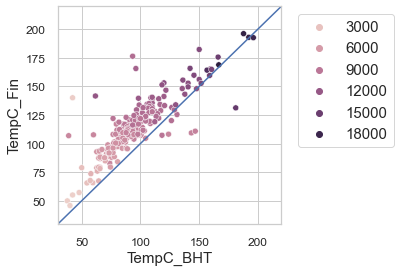

In [247]:
import matplotlib.pyplot as plt
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(4,4))

sns.scatterplot(data=Eaglebine_Combined_stat, x="TempC_BHT", y="TempC_Fin", hue='BHT_below sea level (ft)', ax=ax)

ax.set_xlim([30, 220])
ax.set_ylim([30, 220])
ax.plot([0, 220], [0, 220])
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

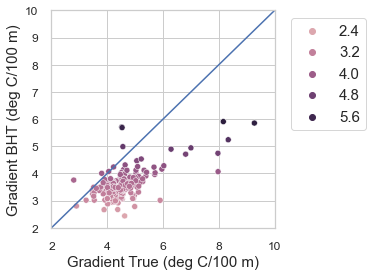

In [248]:
import matplotlib.pyplot as plt
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(4,4))

sns.scatterplot(data=Eaglebine_Combined_stat, x="Gradient True (deg C/100 m)", y="Gradient BHT (deg C/100 m)", hue='Gradient BHT (deg C/100 m)', ax=ax)

ax.set_xlim([2, 10])
ax.set_ylim([2, 10])
ax.plot([2, 10], [2, 10])
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

# 3 Organize Duvernay temperature data

## 3.1 Read in DST BHT input and "true temp" synthetic data

In [249]:
Duvernay_Truth = pd.read_excel(dir_duvernay+'Duvenay TrueTemp_Train.xlsx')
Duvernay_DST = pd.read_excel(dir_duvernay+'Duvernay DST BHT for SPE April 20 2021.xlsx')
Duvernay_Truth.head()

,UWI,Depths subsea (m),True Temperature (oC)
0,100010107020W500,-720,2.53
1,100010107020W500,-700,2.54
2,100010107020W500,-680,2.54
3,100010107020W500,-660,3.30
4,100010107020W500,-640,4.06


In [250]:
print("number of unique wells in 'Duvenay TrueTemp_Train' : " + str(len(pd.unique(Duvernay_Truth['UWI']))))

number of unique wells in 'Duvenay TrueTemp_Train' : 2215


In [251]:
# add in an extra column calculating the depth sub sea (elevation-depth)*-1 
Duvernay_DST['Depth_SS(m)']=-1*(Duvernay_DST['elevation M above sea level']-(Duvernay_DST['DST Start Depth (MD) (m)']+Duvernay_DST['DST End Depth (MD) (m)'])/2)
Duvernay_DST.head()

,Well ID,DST Start Depth (MD) (m),DST End Depth (MD) (m),DST Bottom Hole Temp. (degC),DST Test Date,Test Type,DST Misrun,DST Number,Formation DSTd,Unnamed: 9,elevation M above sea level,UWI,Depth_SS(m)
0,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0
1,100010608109W500,1686.0,1694.0,34.26,33647,DST,N,1,Dmuskeg,NaN,645.6,100010608109W500,1044.4
2,100010904012W500,3698.0,3718.0,104.40,30798,LRT,N,1,Melkton,NaN,1283.8,100010904012W500,2424.2
3,100011206021W400,822.0,825.0,29.00,29543,DST,N,4,Dwintrbrn,NaN,651.6,100011206021W400,171.9
4,100011506915W500,1801.0,1818.0,64.00,30760,DST,N,4,Dwabamun,NaN,873.1,100011506915W500,936.4


In [252]:
print("number of unique wells in 'Duvernay_DST' : " + str(len(pd.unique(Duvernay_DST['UWI']))))

number of unique wells in 'Duvernay_DST' : 512


In [253]:
# gradients dv
GLdv=Duvernay_DST[['UWI','elevation M above sea level']]

dv_Truegrad=Duvernay_Truth.merge(GLdv, left_on='UWI', right_on='UWI', how='left')
dv_Truegrad['md (m)']= (dv_Truegrad['Depths subsea (m)']+dv_Truegrad['elevation M above sea level'])
dv_Truegrad['Gradient True degC/100m'] = dv_Truegrad['True Temperature (oC)']/dv_Truegrad['md (m)']*100

dv_Truegrad=dv_Truegrad.drop(dv_Truegrad[dv_Truegrad['md (m)']<=1].index)
dv_Truegrad=dv_Truegrad.drop(dv_Truegrad[dv_Truegrad['True Temperature (oC)']<=25].index)

dv_Truegrad.head()

,UWI,Depths subsea (m),True Temperature (oC),elevation M above sea level,md (m),Gradient True degC/100m
30,100010107020W500,-120,25.01,701.0,581.0,4.304647
31,100010107020W500,-100,26.02,701.0,601.0,4.329451
32,100010107020W500,-80,27.03,701.0,621.0,4.352657
33,100010107020W500,-60,28.04,701.0,641.0,4.374415
34,100010107020W500,-40,29.05,701.0,661.0,4.394856


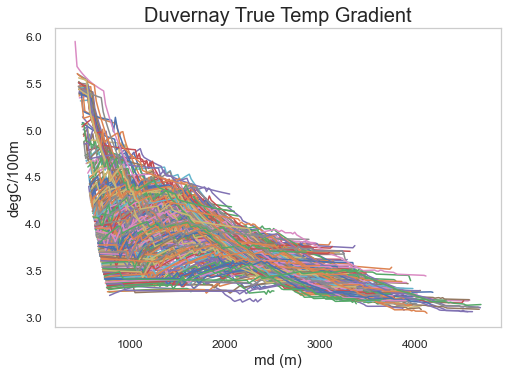

In [254]:
fig, ax = plt.subplots()
for key, grp in dv_Truegrad.groupby('UWI'):
    ax = grp.plot(x = 'md (m)', y = 'Gradient True degC/100m',ax = ax, kind='line',legend=False)
    plt.ylabel('degC/100m')
    plt.title('Duvernay True Temp Gradient')
    plt.grid(b=None, which='major', axis='both')

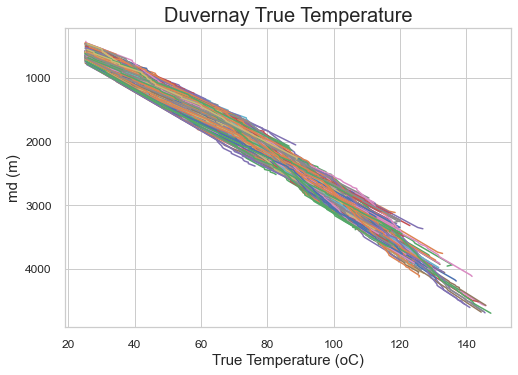

In [255]:
fig, ax = plt.subplots()
for key, grp in dv_Truegrad.groupby('UWI'):
    ax = grp.plot(y = 'md (m)', x = 'True Temperature (oC)',ax = ax, kind='line',legend=False)
    plt.ylabel('md (m)')
    plt.title('Duvernay True Temperature')
    plt.gca().invert_yaxis()

In [256]:
# merge
Duvernay_Combined = Duvernay_DST.merge(Duvernay_Truth, on='UWI', how='left')
Duvernay_Combined.head()

,Well ID,DST Start Depth (MD) (m),DST End Depth (MD) (m),DST Bottom Hole Temp. (degC),DST Test Date,Test Type,DST Misrun,DST Number,Formation DSTd,Unnamed: 9,elevation M above sea level,UWI,Depth_SS(m),Depths subsea (m),True Temperature (oC)
0,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0,-720.0,2.53
1,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0,-700.0,2.54
2,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0,-680.0,2.54
3,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0,-660.0,3.30
4,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0,-640.0,4.06


In [257]:
# keep only the synthetic model temperature data for the relevant depths for which there is BHT measurement
Duvernay_Combined['diff_depth'] = Duvernay_Combined['Depth_SS(m)']-Duvernay_Combined['Depths subsea (m)']
Duvernay_Combined['diff_depth_abs'] = np.abs(Duvernay_Combined['diff_depth'])
idx = Duvernay_Combined.groupby(['UWI'])['diff_depth_abs'].transform(min) == Duvernay_Combined['diff_depth_abs']

TrueTempUWI = Duvernay_Combined.loc[idx, ['UWI', 'diff_depth_abs', 'True Temperature (oC)', 'diff_depth']]
TrueTempUWI = TrueTempUWI.copy(deep=True)
Duvernay_Combined_cln = Duvernay_DST.merge(TrueTempUWI, on='UWI', how='left')
Duvernay_Combined_cln = Duvernay_Combined_cln.drop_duplicates(['UWI'])
Duvernay_Combined_cln.head()

,Well ID,DST Start Depth (MD) (m),DST End Depth (MD) (m),DST Bottom Hole Temp. (degC),DST Test Date,Test Type,DST Misrun,DST Number,Formation DSTd,Unnamed: 9,elevation M above sea level,UWI,Depth_SS(m),diff_depth_abs,True Temperature (oC),diff_depth
0,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,701.0,100010107020W500,716.0,4.0,60.97,-4.0
1,100010608109W500,1686.0,1694.0,34.26,33647,DST,N,1,Dmuskeg,NaN,645.6,100010608109W500,1044.4,4.4,63.98,4.4
2,100010904012W500,3698.0,3718.0,104.40,30798,LRT,N,1,Melkton,NaN,1283.8,100010904012W500,2424.2,NaN,NaN,NaN
3,100011206021W400,822.0,825.0,29.00,29543,DST,N,4,Dwintrbrn,NaN,651.6,100011206021W400,171.9,8.1,39.07,-8.1
4,100011506915W500,1801.0,1818.0,64.00,30760,DST,N,4,Dwabamun,NaN,873.1,100011506915W500,936.4,3.6,69.47,-3.6


In [258]:
Duvernay_Combined_cln.isna().sum()

Well ID                           0
DST Start Depth (MD) (m)          0
DST End Depth (MD) (m)            0
DST Bottom Hole Temp. (degC)      0
DST Test Date                     0
Test Type                         0
DST Misrun                        0
DST Number                        0
Formation DSTd                    0
Unnamed: 9                      512
elevation M above sea level       0
UWI                               0
Depth_SS(m)                       0
diff_depth_abs                  140
True Temperature (oC)           140
diff_depth                      140
dtype: int64

## 3.2 Merge in static temperature log data

In [259]:
Duvernay_Combined_cln['UWI'] = Duvernay_Combined_cln['UWI'].astype(str)
Duvernay_Combined_cln = Duvernay_Combined_cln.copy(deep=True)
Duvernay_Combined_cln['TrueTemp_datasource_syn'] = 'synthetic'
Static_log_temp['TrueTemp_datasource_stat'] = 'static_temp_logs'
Duvernay_Combined_stat = Duvernay_Combined_cln.merge(Static_log_temp, left_on='UWI',right_on='Well_ID', how='left')

In [260]:
Static_log_temp.head()

,Well_ID,Depth (ft),Temp (degC),Field,TrueTemp_datasource_stat
0,42013301930000,10700.0,132.778000,Eaglebine,static_temp_logs
1,42041305800000,7360.0,82.777778,Eaglebine,static_temp_logs
2,42041311700000,7828.0,118.888889,Eaglebine,static_temp_logs
3,42041311980000,7954.0,105.000000,Eaglebine,static_temp_logs
4,42051305380000,8380.0,111.111111,Eaglebine,static_temp_logs


In [261]:
# Coalesce columns together with priority for true temperature measurements
Duvernay_Combined_stat['TempC_Fin'] = Duvernay_Combined_stat['Temp (degC)'].fillna(Duvernay_Combined_stat['True Temperature (oC)'])
Duvernay_Combined_stat['TrueTemp_datasource'] = Duvernay_Combined_stat['TrueTemp_datasource_stat'].fillna(Duvernay_Combined_stat['TrueTemp_datasource_syn'])

Duvernay_Combined_stat.head()

,Well ID,DST Start Depth (MD) (m),DST End Depth (MD) (m),DST Bottom Hole Temp. (degC),DST Test Date,Test Type,DST Misrun,DST Number,Formation DSTd,Unnamed: 9,...,True Temperature (oC),diff_depth,TrueTemp_datasource_syn,Well_ID,Depth (ft),Temp (degC),Field,TrueTemp_datasource_stat,TempC_Fin,TrueTemp_datasource
0,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,...,60.97,-4.0,synthetic,NaN,NaN,NaN,NaN,NaN,60.97,synthetic
1,100010608109W500,1686.0,1694.0,34.26,33647,DST,N,1,Dmuskeg,NaN,...,63.98,4.4,synthetic,NaN,NaN,NaN,NaN,NaN,63.98,synthetic
2,100010904012W500,3698.0,3718.0,104.40,30798,LRT,N,1,Melkton,NaN,...,NaN,NaN,synthetic,NaN,NaN,NaN,NaN,NaN,NaN,synthetic
3,100011206021W400,822.0,825.0,29.00,29543,DST,N,4,Dwintrbrn,NaN,...,39.07,-8.1,synthetic,NaN,NaN,NaN,NaN,NaN,39.07,synthetic
4,100011506915W500,1801.0,1818.0,64.00,30760,DST,N,4,Dwabamun,NaN,...,69.47,-3.6,synthetic,NaN,NaN,NaN,NaN,NaN,69.47,synthetic


In [262]:
Duvernay_Combined_stat['DST Mid_point TMD (m)']= (Duvernay_Combined_stat['DST Start Depth (MD) (m)']+Duvernay_Combined_stat['DST End Depth (MD) (m)'])/2
Duvernay_Combined_stat['Gradient True (deg C/100 m)']=Duvernay_Combined_stat['TempC_Fin']/Duvernay_Combined_stat['DST Mid_point TMD (m)']*100
Duvernay_Combined_stat['Gradient BHT (deg C/100 m)']=Duvernay_Combined_stat['DST Bottom Hole Temp. (degC)']/Duvernay_Combined_stat['DST Mid_point TMD (m)']*100
Duvernay_Combined_stat['GL(ft)']= Duvernay_Combined_stat['elevation M above sea level']/.3048
Duvernay_Combined_stat['DST Mid_point TMD (ft)']= Duvernay_Combined_stat['DST Mid_point TMD (m)']/.3048
Duvernay_Combined_stat['Depth sub-sea (feet)']=Duvernay_Combined_stat['Depth_SS(m)']/.3048

Duvernay_Combined_stat.to_csv('StructuredData/Duvernay_Combined_stat.csv')
Duvernay_Combined_stat.head()

,Well ID,DST Start Depth (MD) (m),DST End Depth (MD) (m),DST Bottom Hole Temp. (degC),DST Test Date,Test Type,DST Misrun,DST Number,Formation DSTd,Unnamed: 9,...,Field,TrueTemp_datasource_stat,TempC_Fin,TrueTemp_datasource,DST Mid_point TMD (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),GL(ft),DST Mid_point TMD (ft),Depth sub-sea (feet)
0,100010107020W500,1410.6,1423.4,48.33,26025,DST,N,2,TRmontney,NaN,...,NaN,NaN,60.97,synthetic,1417.0,4.302752,3.410727,2299.868766,4648.950131,2349.081365
1,100010608109W500,1686.0,1694.0,34.26,33647,DST,N,1,Dmuskeg,NaN,...,NaN,NaN,63.98,synthetic,1690.0,3.785799,2.027219,2118.110236,5544.619423,3426.509186
2,100010904012W500,3698.0,3718.0,104.40,30798,LRT,N,1,Melkton,NaN,...,NaN,NaN,NaN,synthetic,3708.0,NaN,2.815534,4211.942257,12165.354331,7953.412073
3,100011206021W400,822.0,825.0,29.00,29543,DST,N,4,Dwintrbrn,NaN,...,NaN,NaN,39.07,synthetic,823.5,4.744384,3.521554,2137.795276,2701.771654,563.976378
4,100011506915W500,1801.0,1818.0,64.00,30760,DST,N,4,Dwabamun,NaN,...,NaN,NaN,69.47,synthetic,1809.5,3.839182,3.536889,2864.501312,5936.679790,3072.178478


In [263]:
Duvernay_Combined_stat.isna().sum()

Well ID                           0
DST Start Depth (MD) (m)          0
DST End Depth (MD) (m)            0
DST Bottom Hole Temp. (degC)      0
DST Test Date                     0
Test Type                         0
DST Misrun                        0
DST Number                        0
Formation DSTd                    0
Unnamed: 9                      512
elevation M above sea level       0
UWI                               0
Depth_SS(m)                       0
diff_depth_abs                  140
True Temperature (oC)           140
diff_depth                      140
TrueTemp_datasource_syn           0
Well_ID                         490
Depth (ft)                      491
Temp (degC)                     490
Field                           490
TrueTemp_datasource_stat        490
TempC_Fin                       140
TrueTemp_datasource               0
DST Mid_point TMD (m)             0
Gradient True (deg C/100 m)     140
Gradient BHT (deg C/100 m)        0
GL(ft)                      

## 3.3 Plot the temp data

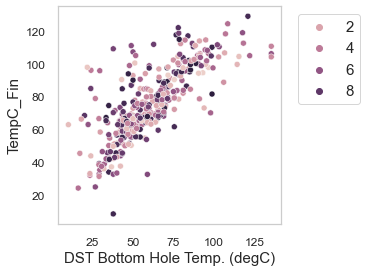

In [264]:
import matplotlib.pyplot as plt
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(4,4))

sns.scatterplot(data=Duvernay_Combined_stat, 
                x="DST Bottom Hole Temp. (degC)",
                y="TempC_Fin",
                hue='diff_depth_abs', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

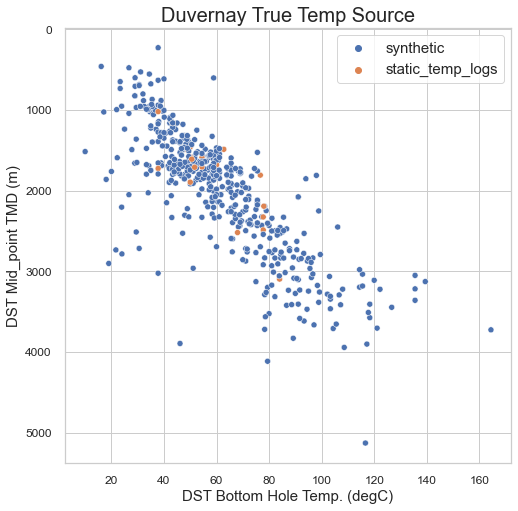

In [265]:
import matplotlib.pyplot as plt
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(8,8))
plt.title("Duvernay True Temp Source")
sns.scatterplot(data=Duvernay_Combined_stat, 
                x="DST Bottom Hole Temp. (degC)",
                y="DST Mid_point TMD (m)",
                hue='TrueTemp_datasource', ax=ax)

plt.legend()
plt.gca().invert_yaxis()


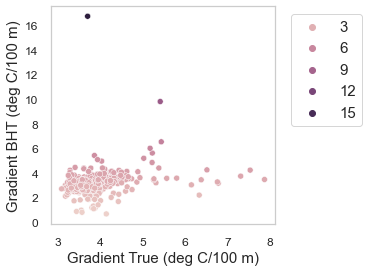

In [266]:
import matplotlib.pyplot as plt
plt.close('all')
fig, ax = plt.subplots(1, 1, figsize=(4,4))

sns.scatterplot(data=Duvernay_Combined_stat, x="Gradient True (deg C/100 m)", y="Gradient BHT (deg C/100 m)", hue='Gradient BHT (deg C/100 m)', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")

# 4 Combine Eaglebine and Duvernay temperature datasets

In [267]:
cols = Eaglebine_Combined_stat.columns.tolist()
cols

['UWI',
 'SurfLat',
 'SurfLong',
 'TD (ft)',
 'GL(ft)',
 'BHT_below sea level (ft)',
 'BHT_ subsurface (ft)',
 'BHTorMRT (maximum recorded temperature) oF',
 'TSC or ORT (time since circulation or original recorded time in hours)',
 'TempC_BHT',
 'diff_depth_abs',
 'TempTrue_degC',
 'Depth sub-sea (feet)',
 'TrueTemp_datasource_syn',
 'Well_ID',
 'Depth (ft)',
 'Temp (degC)',
 'Field',
 'TrueTemp_datasource_stat',
 'TempC_Fin',
 'TrueTemp_datasource',
 'BHT_ subsurface (m)',
 'Depth_SS(m)',
 'diff_depth_abs (m)',
 'diff_depth (m)',
 'Gradient True (deg C/100 m)',
 'Gradient BHT (deg C/100 m)']

In [268]:
Duvernay = Duvernay_Combined_stat[['UWI', 'DST Bottom Hole Temp. (degC)', 'TempC_Fin','Depth_SS(m)'\
                                   ,'DST Mid_point TMD (m)','Gradient True (deg C/100 m)'\
                                   ,'Gradient BHT (deg C/100 m)','Test Type','DST Misrun'\
                                   ,'Formation DSTd','diff_depth','TrueTemp_datasource', 'Depth sub-sea (feet)'\
                                   ,'GL(ft)', 'elevation M above sea level', 'DST Mid_point TMD (ft)']]

Duvernay = Duvernay.rename(columns={'DST Bottom Hole Temp. (degC)': 'BHT','TempC_Fin':'TrueTemp'\
                                   ,'DST Mid_point TMD (m)':'BHT_ subsurface (m)'\
                                   ,'diff_depth':'diff_depth (m)','elevation M above sea level':'GL(m)'\
                                   ,'DST Mid_point TMD (ft)':'BHT_ subsurface (ft)'})
Duvernay['Field'] = 'Duvernay'

Eaglebine = Eaglebine_Combined_stat[['UWI', 'TempC_BHT', 'TempC_Fin', 'GL(ft)','TD (ft)','Depth_SS(m)'\
                                   ,'BHT_ subsurface (ft)','BHT_ subsurface (m)','Gradient True (deg C/100 m)'\
                                   ,'Gradient BHT (deg C/100 m)', 'Depth sub-sea (feet)'\
                                   ,'TSC or ORT (time since circulation or original recorded time in hours)'\
                                   ,'diff_depth (m)','TrueTemp_datasource']]

Eaglebine = Eaglebine.rename(columns={'TempC_BHT': 'BHT', 'TempC_Fin': 'TrueTemp'})
Eaglebine['Field'] = 'Eaglebine'

combined_temperature = pd.concat((Duvernay, Eaglebine))

combined_temperature['deltaT'] = combined_temperature['TrueTemp'] -combined_temperature['BHT'] 

combined_temperature.columns.tolist()

['UWI',
 'BHT',
 'TrueTemp',
 'Depth_SS(m)',
 'BHT_ subsurface (m)',
 'Gradient True (deg C/100 m)',
 'Gradient BHT (deg C/100 m)',
 'Test Type',
 'DST Misrun',
 'Formation DSTd',
 'diff_depth (m)',
 'TrueTemp_datasource',
 'Depth sub-sea (feet)',
 'GL(ft)',
 'GL(m)',
 'BHT_ subsurface (ft)',
 'Field',
 'TD (ft)',
 'TSC or ORT (time since circulation or original recorded time in hours)',
 'deltaT']

In [269]:
cols_to_move = ['UWI', 'BHT', 'TrueTemp', 'deltaT', 'Depth sub-sea (feet)','Depth_SS(m)', 'BHT_ subsurface (ft)','BHT_ subsurface (m)','GL(ft)', 'GL(m)']
combined_temperature = combined_temperature[ cols_to_move + [ col for col in combined_temperature.columns if col not in cols_to_move ] ]
combined_temperature.head()

,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),GL(m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Test Type,DST Misrun,Formation DSTd,diff_depth (m),TrueTemp_datasource,Field,TD (ft),TSC or ORT (time since circulation or original recorded time in hours)
0,100010107020W500,48.33,60.97,12.64,2349.081365,716.0,4648.950131,1417.0,2299.868766,701.0,4.302752,3.410727,DST,N,TRmontney,-4.0,synthetic,Duvernay,NaN,NaN
1,100010608109W500,34.26,63.98,29.72,3426.509186,1044.4,5544.619423,1690.0,2118.110236,645.6,3.785799,2.027219,DST,N,Dmuskeg,4.4,synthetic,Duvernay,NaN,NaN
2,100010904012W500,104.40,NaN,NaN,7953.412073,2424.2,12165.354331,3708.0,4211.942257,1283.8,NaN,2.815534,LRT,N,Melkton,NaN,synthetic,Duvernay,NaN,NaN
3,100011206021W400,29.00,39.07,10.07,563.976378,171.9,2701.771654,823.5,2137.795276,651.6,4.744384,3.521554,DST,N,Dwintrbrn,-8.1,synthetic,Duvernay,NaN,NaN
4,100011506915W500,64.00,69.47,5.47,3072.178478,936.4,5936.679790,1809.5,2864.501312,873.1,3.839182,3.536889,DST,N,Dwabamun,-3.6,synthetic,Duvernay,NaN,NaN


##### Check for high bh temp gradient

In [270]:
combined_temperature.sort_values(by='Gradient True (deg C/100 m)',ascending=False).head(3)

,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),GL(m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Test Type,DST Misrun,Formation DSTd,diff_depth (m),TrueTemp_datasource,Field,TD (ft),TSC or ORT (time since circulation or original recorded time in hours)
117,42123309360000,42.222222,140.000000,97.777778,2100.0,647.66952,2518.4,767.60832,393.5,NaN,21.615962,5.500490,NaN,NaN,NaN,7.58952,static_temp_logs,Eaglebine,14460.0,3.5
116,42123303590000,42.222222,55.061728,12.839506,1950.0,593.75040,2366.4,721.27872,418.4,NaN,9.273548,5.853801,NaN,NaN,NaN,-0.60960,static_temp_logs,Eaglebine,14600.0,3.5
122,42127000690000,47.777778,57.194444,9.416667,2250.0,686.07432,2991.6,911.83968,740.7,NaN,8.336479,5.239713,NaN,NaN,NaN,0.27432,synthetic,Eaglebine,8185.0,1.5


In [271]:
combined_temperature.sort_values(by='Gradient BHT (deg C/100 m)',ascending=False).head(3)

,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),GL(m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Test Type,DST Misrun,Formation DSTd,diff_depth (m),TrueTemp_datasource,Field,TD (ft),TSC or ORT (time since circulation or original recorded time in hours)
466,100142904806W500,37.78,8.37,-29.41,-2070.045932,-630.95,739.993438,225.55,2810.039370,856.5,3.710929,16.750166,DST,N,Tpaskapoo,9.05,synthetic,Duvernay,NaN,NaN
137,100060807808W500,58.90,32.52,-26.38,-218.503937,-66.60,1970.144357,600.50,2188.648294,667.1,5.415487,9.808493,DST,N,Mpekisko,-6.60,synthetic,Duvernay,NaN,NaN
473,100152507708W500,40.00,33.32,-6.68,-244.094488,-74.40,2009.514436,612.50,2253.608924,686.9,5.440000,6.530612,DST,N,Mbanff,5.60,synthetic,Duvernay,NaN,NaN


In [272]:
# save this structured data to file
#! mkdir StructuredData
combined_temperature.to_csv('StructuredData/combined_temperature.csv')

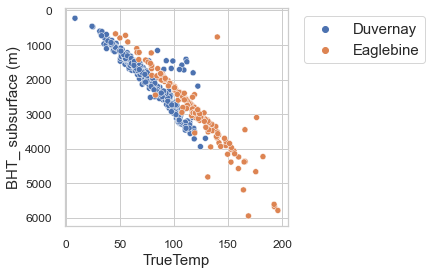

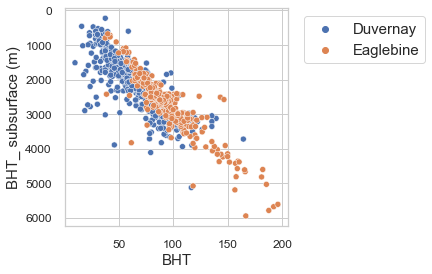

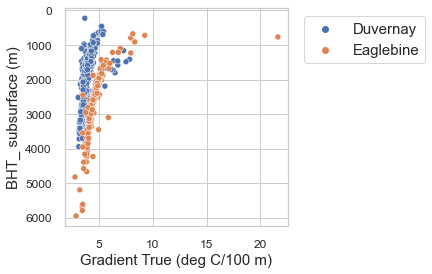

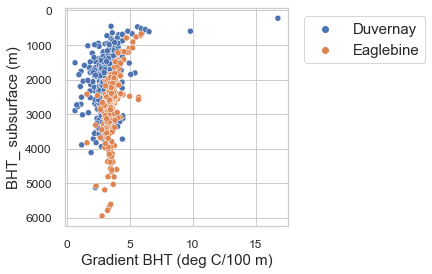

In [273]:
plt.close('all')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="TrueTemp",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="BHT",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="Gradient True (deg C/100 m)",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="Gradient BHT (deg C/100 m)",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

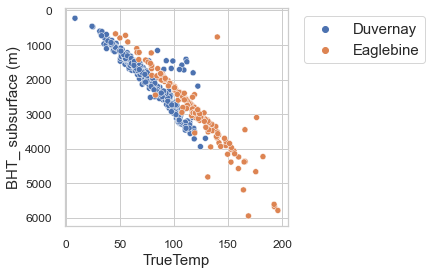

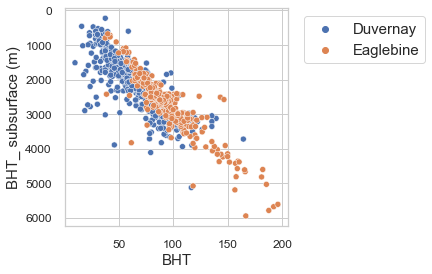

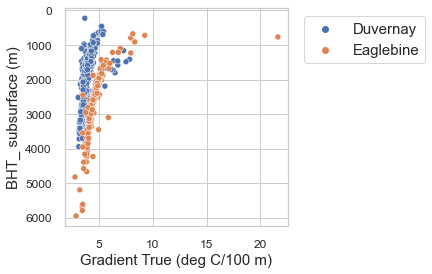

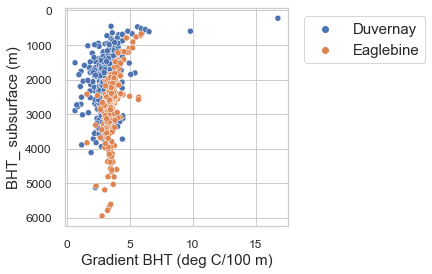

In [274]:
plt.close('all')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="TrueTemp",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="BHT",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="Gradient True (deg C/100 m)",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=combined_temperature, 
                x="Gradient BHT (deg C/100 m)",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

<AxesSubplot:xlabel='Gradient BHT (deg C/100 m)', ylabel='BHT_ subsurface (m)'>

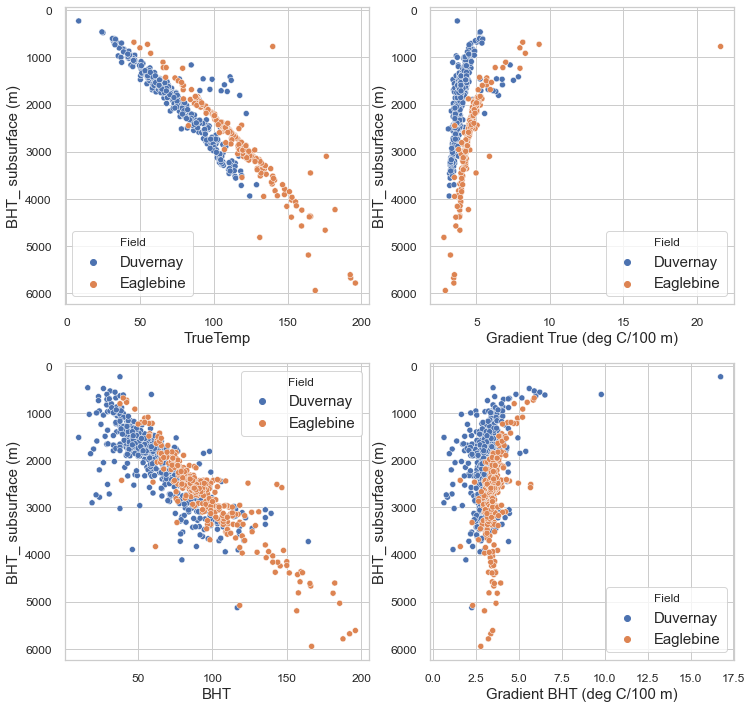

In [275]:
plt.close('all')

fig, axes = plt.subplots(2, 2, sharex=False, figsize=(12,12))

axes[0,0].invert_yaxis()
axes[0,1].invert_yaxis()
axes[1,0].invert_yaxis()
axes[1,1].invert_yaxis()

sns.scatterplot(ax=axes[0,0], data=combined_temperature, x="TrueTemp", y="BHT_ subsurface (m)", hue='Field')
sns.scatterplot(ax=axes[1,0], data=combined_temperature, x="BHT", y="BHT_ subsurface (m)", hue='Field')

sns.scatterplot(ax=axes[0,1], data=combined_temperature, x="Gradient True (deg C/100 m)", y="BHT_ subsurface (m)", hue='Field')
sns.scatterplot(ax=axes[1,1], data=combined_temperature, x="Gradient BHT (deg C/100 m)", y="BHT_ subsurface (m)", hue='Field')

[(2.0, 10.0), (6000.0, 0.0)]

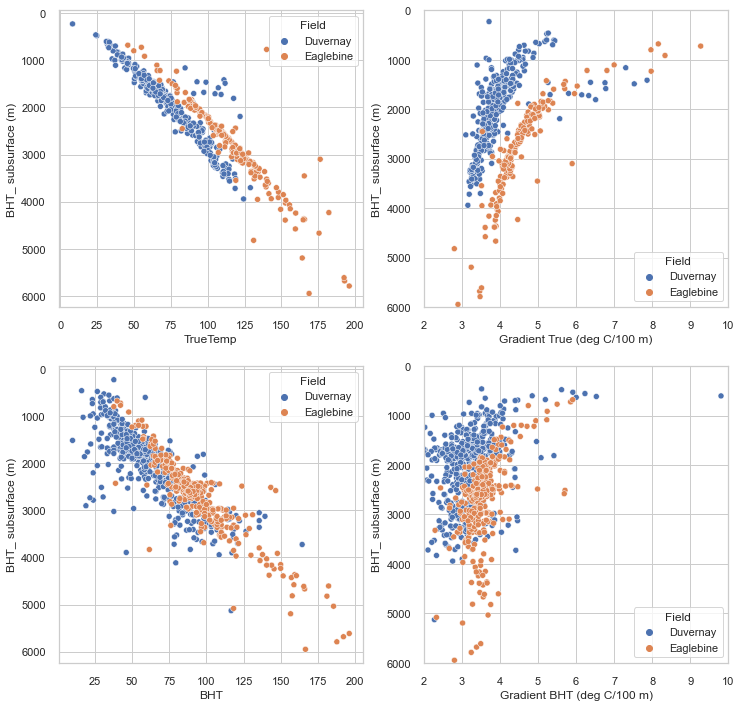

In [549]:
plt.close('all')

fig, axes = plt.subplots(2, 2, sharex=False, figsize=(12,12))

axes[0,0].invert_yaxis()
axes[0,1].invert_yaxis()
axes[1,0].invert_yaxis()
axes[1,1].invert_yaxis()

sns.scatterplot(ax=axes[0,0], data=combined_temperature, x="TrueTemp", y="BHT_ subsurface (m)", hue='Field')
sns.scatterplot(ax=axes[1,0], data=combined_temperature, x="BHT", y="BHT_ subsurface (m)", hue='Field')

sns.scatterplot(ax=axes[0,1], data=combined_temperature, x="Gradient True (deg C/100 m)", y="BHT_ subsurface (m)", hue='Field').set(xlim=(2,10),ylim=(6000,0))
sns.scatterplot(ax=axes[1,1], data=combined_temperature, x="Gradient BHT (deg C/100 m)", y="BHT_ subsurface (m)", hue='Field').set(xlim=(2,10),ylim=(6000,0))

<AxesSubplot:xlabel='Gradient BHT (deg C/100 m)', ylabel='Depth_SS(m)'>

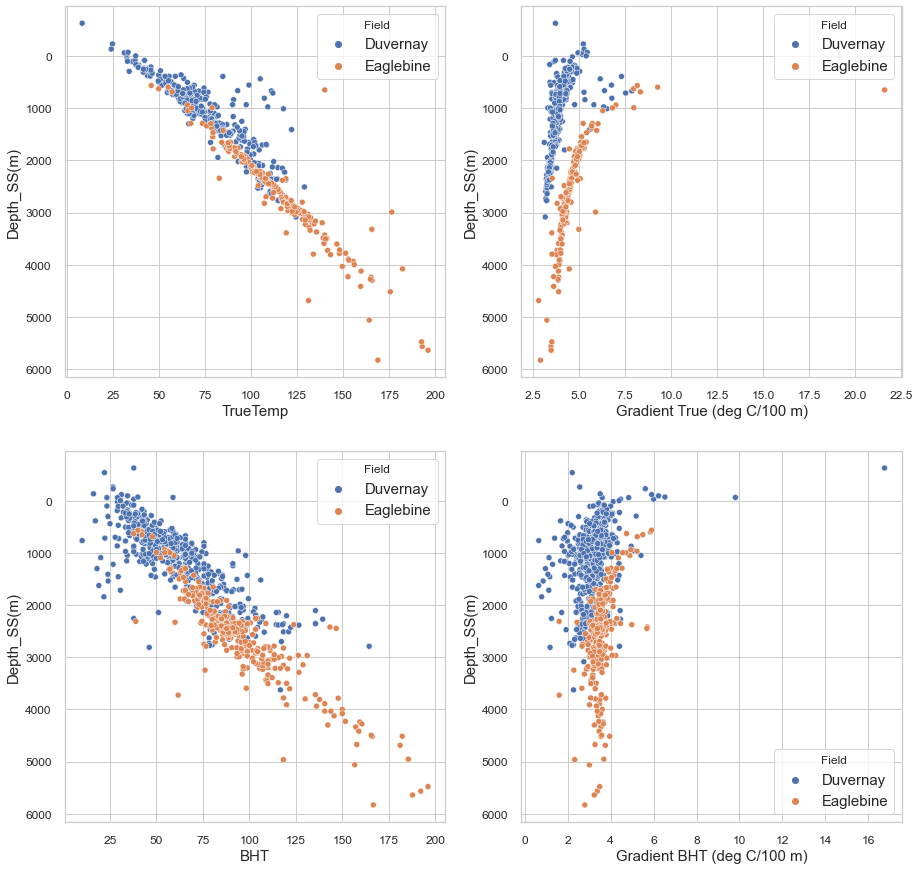

In [276]:
plt.close('all')

fig, axes = plt.subplots(2, 2, sharex=False, figsize=(15,15))

axes[0,0].invert_yaxis()
axes[0,1].invert_yaxis()
axes[1,0].invert_yaxis()
axes[1,1].invert_yaxis()

sns.scatterplot(ax=axes[0,0], data=combined_temperature, x="TrueTemp", y="Depth_SS(m)", hue='Field')
sns.scatterplot(ax=axes[1,0], data=combined_temperature, x="BHT", y="Depth_SS(m)", hue='Field')

sns.scatterplot(ax=axes[0,1], data=combined_temperature, x="Gradient True (deg C/100 m)", y="Depth_SS(m)", hue='Field')
sns.scatterplot(ax=axes[1,1], data=combined_temperature, x="Gradient BHT (deg C/100 m)", y="Depth_SS(m)", hue='Field')

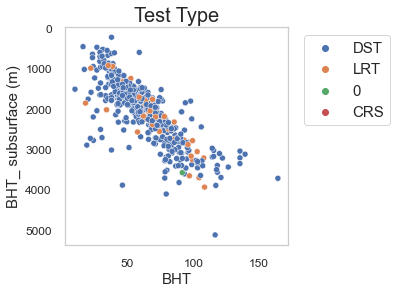

In [277]:
ForPlot = combined_temperature.loc[(combined_temperature['Field'] == 'Duvernay')]

plt.close('all')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=ForPlot, 
                x="BHT",
                y="BHT_ subsurface (m)",
                hue='Test Type', ax=ax)
plt.title('Test Type')
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")


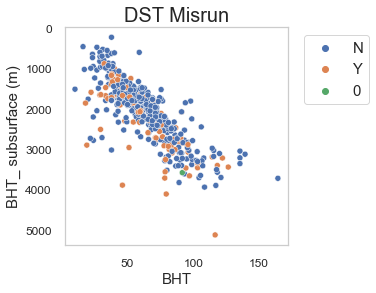

In [278]:
ForPlot = combined_temperature.loc[(combined_temperature['Field'] == 'Duvernay')]

plt.close('all')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=ForPlot, 
                x="BHT",
                y="BHT_ subsurface (m)",
                hue='DST Misrun', ax=ax,)
plt.title('DST Misrun')
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")



#### Pandas Profiling

In [279]:
df=combined_temperature
profile = ProfileReport(df, title="Pandas Profiling Report")
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/35 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

# 5 Organize Mud-weight, formation, well header, and production data

This section consolidates the files provided by GTS. List of imported files and the dataframe names:

- Eaglebine mud weight SPE April 21 2021.xlsx: **EB_MW**
- Eaglebine formation tops SPE April 20 2021.xlsx: **EB_FT**
- Eaglebine well headers SPE April 21 2021.xlsx: **EB_WH**
- SPE Eaglebine production summary April 20 2021.xlsx: **EB_PS**
- Duvernay formation tops SPE April 20 2021.xlsx: **DV_FT**
- Duvernay well headers SPE April 21 2021 .xlsx: **DV_WH**
- SPE Duvernay production summary April 20 2021.xlsx: **DV_PS**

**Workflow: add the multiple entries as attributes**

1. read the excel file into a dataframe. Leave the indexing out at this stage.
1. for each well number (Well_Id), tag the multiple entries in a new column.
    - New column name: 'attribute_' + the name of the column with multiple entries.
    - Tag: name of the column with multiple entries + sequential number for multiple entries in that column
1. reshape the featured table to pivot on the attribute
1. check for dupblicates on 'Well_Id' after reshaping. If duplicates exist inspect all columns for each well. If no duplicates, it's ready for merge


(Thanks Korang Modaressi for code)

In [280]:
files_to_upload = {'file': ['Eaglebine mud weight SPE April 21 2021.xlsx', 
                         'Eaglebine formation tops SPE April 20 2021.xlsx',
                         'Eaglebine well headers SPE April 21 2021.xlsx',
                         'SPE Eaglebine production summary April 20 2021.xlsx',
                         'Duvernay formation tops SPE April 20 2021.xlsx',
                         'Duvernay well headers SPE April 21 2021 .xlsx',
                         'SPE Duvernay production summary April 20 2021.xlsx'],
                  'df_name': ['EB_MW', 'EB_FT', 'EB_WH', 'EB_PS', 'DV_FT', 'DV_WH', 'DV_PS']}
files_to_upload['flat_df_name'] = [str(c) + '_flat' for c in files_to_upload['df_name']]
print(files_to_upload['flat_df_name'])
print(files_to_upload['df_name'][0][:2])

['EB_MW_flat', 'EB_FT_flat', 'EB_WH_flat', 'EB_PS_flat', 'DV_FT_flat', 'DV_WH_flat', 'DV_PS_flat']
EB


In [281]:
EB_MW = pd.read_excel(dir_eaglebine+"Eaglebine mud weight SPE April 21 2021.xlsx")
display(EB_MW.head())
EB_MW.columns = [c.strip() for c in EB_MW.columns.values.tolist()]
EB_MW.rename(columns = {'UWI': 'Well_Id'}, inplace = True)

,UWI,TD,KB,Mud Wt,MW@Depth(KB)
0,42013301410000,19629,327.5,9.3,4404
1,42013301410000,19629,327.5,11.9,12550
2,42013301410000,19629,327.5,11.2,12650
3,42013301410000,19629,327.5,11.9,12650
4,42013301410000,19629,327.5,11.9,14390


In [282]:
EB_FT = pd.read_excel(dir_eaglebine+"Eaglebine formation tops SPE April 20 2021.xlsx")
display(EB_FT.head())
EB_FT.columns = [c.strip() for c in EB_FT.columns.values.tolist()]
EB_FT.rename(columns = {'UWI': 'Well_Id'}, inplace = True)

,UWI,Bottom_Hole_Location_X,Bottom_Hole_Location_Y,Elevation(f),Elevation_Reference,Latitude,Longitude,Total_Depth(f),X(f),Y(f),...,10_Maness_MD_ft,11_Buda_MD_ft,12_Del_Rio_MD_ft,13_Georgetown_MD_ft,14_Edwards_MD_ft,15_Glen_Rose_MD_ft,16_Pearsal_MD_ft,17_James_Cow_Creek_MD_ft,18_Sligo_MD_ft,19_Cotton_Valley_MD_ft
0,42013301410000,2170169.05,311696.26,328.0,KB,28.689529,-98.469238,0,2170169.05,311696.26,...,0.0,9712.58,9809.80,9862.60,9942.73,10796.27,12251.06,12534.95,12718.48,0.0
1,42013301930000,2253601.52,345032.51,379.0,KB,28.779921,-98.208313,0,2253601.52,345032.51,...,0.0,10280.42,10366.00,10405.21,0.00,0.00,0.00,0.00,0.00,0.0
2,42013302760000,2184830.73,422595.91,442.0,KB,28.994360,-98.421799,6168,2184830.73,422595.91,...,0.0,6100.62,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0
3,42013305480000,2225271.51,411448.83,392.0,KB,28.963091,-98.295502,0,2225271.51,411448.83,...,0.0,7807.00,7908.82,7964.25,0.00,0.00,0.00,0.00,0.00,0.0
4,42013310190000,2270478.34,358777.49,491.0,KB,28.817400,-98.155319,0,2270478.34,358777.49,...,0.0,10393.50,10469.50,10503.75,10566.88,0.00,0.00,0.00,0.00,0.0


In [283]:
EB_WH = pd.read_excel(dir_eaglebine+"Eaglebine well headers SPE April 21 2021.xlsx")
display(EB_WH.head())
EB_WH.rename(columns = {'displayapi': 'Well_Id'}, inplace = True)

,td,Elevation,ElevationDatum,displayapi,WGS84Latitude,WGS84Longitude,SurfLat,SurfLong,SurfaceLatitude_NAD83,SurfaceLongitude_NAD83,BottomLatitude_NAD83,BottomLongitude_NAD83,SurfaceLatitude_NAD27,SurfaceLongitude_NAD27,BottomLatitude_NAD27,BottomLongitude_NAD27
0,19635,338.68,KB,42013301410000,NaN,NaN,NaN,NaN,28.690101,-98.469817,28.690101,-98.469817,28.689839,-98.469523,28.689839,-98.469523
1,10775,384.59,KB,42013301930000,NaN,NaN,NaN,NaN,28.780042,-98.208395,28.780042,-98.208396,28.779784,-98.208109,28.779784,-98.208109
2,6175,442.00,KB,42013302760000,NaN,NaN,NaN,NaN,28.994810,-98.422767,28.994810,-98.422767,28.994561,-98.422475,28.994561,-98.422475
3,8198,392.00,KB,42013305480000,NaN,NaN,NaN,NaN,28.963395,-98.295961,28.963395,-98.295961,28.963144,-98.295673,28.963144,-98.295672
4,11000,493.23,KB,42013310190000,NaN,NaN,NaN,NaN,28.817939,-98.155472,28.817939,-98.155472,28.817682,-98.155187,28.817682,-98.155187


In [284]:
EB_PS = pd.read_excel(dir_eaglebine+"SPE Eaglebine production summary April 20 2021.xlsx")
display(EB_PS.head())
EB_PS.columns = [c.strip() for c in EB_PS.columns.values.tolist()]
EB_PS.rename(columns = {'API': 'Well_Id'}, inplace = True)

,API,Measured Depth (ft),Total Vertical Depth (ft),Spud Date,Completion Date,First Production Month,Elevation,Oil Total Cum (bbl),Gas Total Cum (mcf),Water Total Cum (bbl),...,Drilling Days,Last Production Month,Gas Maximum (mcf),Gas Maximum Date,Oil Maximum (bbl),Oil Maximum Date,Water Maximum (bbl),Water Maximum Date,Liquid Injection Cum (bbl),Gas Injection Cum (mcf)
0,42013301410000,NaN,NaN,1971-02-14,NaT,NaT,NaN,NaN,NaN,NaN,...,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaN
1,42013301930000,NaN,10775.0,NaT,1972-07-22,1972-07-01,363 GL,6140.000,8702967.000,1002330.677,...,NaN,2020-12-01,98093.000,1972-10-01,271.000,2010-03-01,11771.16,1972-10-01,NaN,NaN
2,42013302760000,NaN,6168.0,NaT,1975-07-28,1975-07-01,409 GL,1929.332,7.992,0.000,...,NaN,1981-02-01,0.333,1975-07-01,533.333,1975-08-01,0.00,1975-07-01,NaN,NaN
3,42013305480000,NaN,NaN,1977-01-23,1977-02-24,1977-02-01,267 GL,0.000,10067.000,0.000,...,NaN,1979-08-01,1464.000,1977-04-01,0.000,1977-02-01,0.00,1977-02-01,NaN,NaN
4,42013310190000,NaN,11000.0,1980-08-13,1980-10-25,1980-11-01,NaN,4424.000,6610808.000,47611.388,...,NaN,2020-12-01,63674.000,1981-08-01,108.000,1992-10-01,870.74,1998-05-01,NaN,NaN


In [285]:
DV_FT = pd.read_excel(dir_duvernay+"Duvernay formation tops SPE April 20 2021.xlsx")
display(DV_FT.head())
DV_FT.columns = [c.strip() for c in DV_FT.columns.values.tolist()]
DV_FT.rename(columns = {'UWI': 'Well_Id'}, inplace = True)

,UWI,Bottom Hole Location X_m_NAD27_Zone 11N (120 W to 114 W),Bottom Hole Location Y_m_NAD27_Zone 11N (120 W to 114 W),Elevation(m above sea level),01_Battle (Surbiton)[SSTVD] (m),02_Lea_Park (Surbiton)[SSTVD] (m),03_1st_White_Speckled_Shale (Surbiton)[SSTVD] (m),04_2nd_White_Speckled_Shale (Surbiton)[SSTVD] (m),05_Fish_scales (Surbiton)[SSTVD] (m),06_Mannville_Top (Surbiton)[SSTVD] (m),...,08_Jurassic_Top (Surbiton)[SSTVD] (m),09_Montney_Top (Surbiton)[SSTVD] (m),10_Permian_Top (Surbiton)[SSTVD] (m),11_Wabamun (Surbiton)[SSTVD] (m),12_Winterburn (Surbiton)[SSTVD] (m),13_Woodbend (Surbiton)[SSTVD] (m),14_Duvernay_Top (Surbiton)[SSTVD] (m),15_Beaverhill (Surbiton)[SSTVD] (m),16_Elk_Point (Surbiton)[SSTVD] (m),17_Precambrian Basement (Surbiton)[SSTVD] (m)
0,100010107020W500,506245.60,6097691.89,701.0,NaN,NaN,189.50,-3.4,-214.00,-307.0,...,-627.3,-713.3,NaN,-1271.1,-1508.8,-1605.1,-1900.50,-1937.3,-2044.3,NaN
1,100010608109W500,600487.16,6205637.53,645.6,NaN,NaN,NaN,NaN,390.30,342.5,...,NaN,NaN,NaN,-206.4,-483.9,-604.7,-842.77,-895.4,-1042.5,-1078.4
2,100010904012W500,591372.37,5808846.49,1283.8,NaN,-1081.79,-1265.89,-1741.2,-1984.70,-2034.7,...,-2335.2,NaN,NaN,-2735.2,-3011.2,-3082.2,-3293.20,-3340.2,-3504.7,NaN
3,100011206021W400,760983.75,6009309.66,651.6,NaN,464.00,323.30,190.1,91.10,35.6,...,NaN,NaN,NaN,NaN,-168.4,-246.4,-422.40,-579.4,-811.4,NaN
4,100011506915W500,552047.78,6091428.82,873.1,NaN,293.98,223.10,NaN,-129.94,-213.7,...,NaN,NaN,NaN,-919.8,-1164.7,-1279.7,-1557.30,-1602.2,-1744.9,NaN


In [286]:
DV_WH = pd.read_excel(dir_duvernay+"Duvernay well headers SPE April 21 2021 .xlsx")
display(DV_WH.head())
DV_WH.columns = [c.strip() for c in DV_WH.columns.values.tolist()]
DV_WH.rename(columns = {'UWI': 'Well_Id'}, inplace = True)

,UWI,Elevation Meters,ElevationDatum,TD meters,SurfaceLatitude_NAD83,SurfaceLongitude_NAD83,BottomLatitude_NAD83,BottomLongitude_NAD83,SurfaceLatitude_NAD27,SurfaceLongitude_NAD27,BottomLatitude_NAD27,BottomLongitude_NAD27
0,100072507623W500,555.7,KB,2545.0,55.613640,-117.423800,55.613640,-117.423800,55.613640,-117.423800,55.613640,-117.423800
1,100062007823W500,560.9,KB,2430.0,55.770872,-117.537674,55.770872,-117.537674,55.770872,-117.537674,55.770872,-117.537674
2,100052107723W500,558.4,KB,2515.5,55.683723,-117.516168,55.683723,-117.516168,55.683723,-117.516168,55.683723,-117.516168
3,100061307518W500,631.4,KB,2411.0,55.494600,-116.653606,55.494600,-116.653606,55.494600,-116.653606,55.494600,-116.653606
4,100070907618W500,627.0,KB,2408.0,55.566965,-116.726243,55.566965,-116.726243,55.566965,-116.726243,55.566965,-116.726243


In [287]:
DV_PS = pd.read_excel(dir_duvernay+"SPE Duvernay production summary April 20 2021.xlsx")
display(DV_PS.head())
DV_PS.columns = [c.strip() for c in DV_PS.columns.values.tolist()]
DV_PS.rename(columns = {'API': 'Well_Id'}, inplace = True)

,API,Measured Depth (ft),Total Vertical Depth (ft),Spud Date,Completion Date,First Production Month,Elevation,Oil Total Cum (bbl),Gas Total Cum (mcf),Water Total Cum (bbl),...,Elevation Ground (ft),Elevation Kelly Bushing (ft),Last Production Month,Gas Maximum (mcf),Gas Maximum Date,Oil Maximum (bbl),Oil Maximum Date,Water Maximum (bbl),Water Maximum Date,Yield Total Average
0,100010107020W500,9081,9081,1971-03-11,NaT,NaT,2287 GL,NaN,NaN,NaN,...,2287,2300,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
1,100010608109W500,5725,5725,1992-02-03,1993-01-18,1992-05-01,2103 GL,3422.286,2722.761,390.597,...,2103,2119,1992-08-01,1084.16,1992-07-01,1639.125,1992-05-01,351.6,1992-05-01,1256.918
2,100010904012W500,15797,15797,1983-12-29,NaT,NaT,4186 GL,NaN,NaN,NaN,...,4186,4213,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
3,100011206021W400,4895,4895,1980-11-03,NaT,NaT,2123 GL,NaN,NaN,NaN,...,2123,2139,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
4,100011506915W500,8891,8891,1984-02-21,NaT,NaT,2844 GL,NaN,NaN,NaN,...,2844,2864,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN


In [288]:
# Loop thorugh each well (Well_Id), convert each column into ndarray with Well_Id as key
# Useful functions definitions
''' list the unique well identifiers (Well_Id) in the table and the number of rows for each. The new dataframe will be used to populate the columns of the wide table'''
def wells_and_attributes(df):
    well_data = df
    columns = well_data.columns
    well_data_count = well_data['Well_Id'].value_counts()
    wells = well_data_count.index
    return well_data, wells, columns

''' 
The 'entry_to_attr' function collects the unique Well_Id and pivots entries under each Well_Id into attributes. 
The loop check for each unique well number in well_data_count, loops through columns and pivots the values in each column into a dataframe.
The name of the current column is used as prefix with an underscore "columnname_" joined with suffix as the index (from 0) of the entries for each well. 
The extracted variables are turned into dataframe and is concatenated with the existing dataframe from previous loop. 
'''
def entry_to_attr(df):
    well_data_flat = pd.DataFrame() #dataframe for storing well records after change to wide format
    well_data, wells, columns = wells_and_attributes(df) #read 'wells_and_attributes' function description
    for well in wells:
        well_data_intermediate_flat = pd.DataFrame() #temporary dataframe to store pivoted entries to new attributes for each original column
        well_data_filtered = well_data[well_data['Well_Id'] == well] #filterd for 'well' to start pivoting to new attributes
        #print(well_data_filtered)
        for column in columns: #pivots columns for each well into new attributes
            if column == 'Well_Id': #ignores the Well_Id and flattens othe columns
                continue
            else:
                att_vars = np.array(well_data_filtered[column]) #array containing entries in 'column' for 'well'
                att_count = len(att_vars) #number of entries in the array used for naming the new columns
                att_names = [column+"_"+str(x) for x in range(att_count)] #new column name with number of entries (att_count array's length) as suffix
                well_data_intermediate = pd.DataFrame(att_vars).T #intermediate flat table to be merged with the temporary dataframe
                well_data_intermediate.columns = att_names
                index = pd.Index([well], name = 'Well_Id')
                well_data_intermediate.index = index
                well_data_intermediate_flat = pd.concat([well_data_intermediate_flat, well_data_intermediate], axis = 1)
        well_data_flat = pd.concat([well_data_flat, well_data_intermediate_flat])
    return well_data_flat

In [289]:
'''
In this loop the entry_to_attr funciton is looped for the dataframes:
    'EB_MW', 'EB_FT', 'EB_WH', 'EB_PS', 'DV_FT', 'DV_WH', 'DV_PS'
The resulting wide-format dataframe is stored in a new datafram. 
The wide-format dataframes are concatenated into one dataframe with Well_ID as index
'''
dataframes = [EB_MW, EB_FT, EB_WH, EB_PS, DV_FT, DV_WH, DV_PS]
consolidated_well_data = pd.DataFrame()
cols = []
rows = []
# consolidated_well_data = pd.concat([consolidated_well_data, dataframes[0], dataframes[1], dataframes[2]])
for i in range(len(dataframes)): #
    well_data_flat = entry_to_attr(dataframes[i])
    well_data_flat['Basin'] = files_to_upload['df_name'][i][:2]
    well_data_flat.reset_index(inplace = True)
    well_data_flat.to_excel(str(str(files_to_upload['flat_df_name'][i]) + '.' + 'xlsx'))
    print(well_data_flat.shape)
    well_data_flat.set_index(['Well_Id', 'Basin'], inplace = True)
    consolidated_well_data = pd.concat([consolidated_well_data, well_data_flat], axis = 1)
consolidated_well_data.shape
display(consolidated_well_data.head())
print('the consolidated_well_data has {} rows and {} columns'.format(consolidated_well_data.shape[0], consolidated_well_data.shape[1]))

(316, 54)
(324, 30)
(324, 17)
(308, 90)
(512, 22)


C:\Users\trevo\anaconda3\lib\site-packages\pandas\core\indexes\multi.py:3587: RuntimeWarning: The values in the array are unorderable. Pass `sort=False` to suppress this warning.
  uniq_tuples = lib.fast_unique_multiple([self._values, other._values], sort=sort)


(512, 13)
(512, 25)


,,TD_0,TD_1,TD_2,TD_3,TD_4,TD_5,TD_6,TD_7,TD_8,TD_9,...,Elevation Ground (ft)_0,Elevation Kelly Bushing (ft)_0,Last Production Month_0,Gas Maximum (mcf)_0,Gas Maximum Date_0,Oil Maximum (bbl)_0,Oil Maximum Date_0,Water Maximum (bbl)_0,Water Maximum Date_0,Yield Total Average_0
Well_Id,Basin,,,,,,,,,,,,,,,,,,,,,
42013301410000,EB,19629.0,19629.0,19629.0,19629.0,19629.0,19629.0,19629.0,19629.0,19629.0,19629.0,...,NaN,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
42013301930000,EB,10775.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
42013302760000,EB,6168.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
42013305480000,EB,8198.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN
42013310190000,EB,11000.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN


the consolidated_well_data has 836 rows and 237 columns


In [290]:
consolidated_well_data_no_index = consolidated_well_data.reset_index()
consolidated_well_data.to_csv('StructuredData/consolidated_well_data.csv')
consolidated_well_data.to_excel('StructuredData/consolidated_well_data.xlsx')

# 6 Organize LAS file

In [291]:
### Thanks to Pushpesh Sharma for writing this section

In [292]:
import os
!pip install lasio
import lasio

In [293]:
#Load all files at once into las and las_df to save time
folder='clean_las_files/Clean_LAS/'
all_files = os.listdir(folder)
n_files = len(all_files)

bad_files = []

las = {}
las_df = {}
mnemonics ={}
i=0
for filename in tqdm(os.listdir(folder)):
    i=i+1
    if filename.endswith(".LAS"):
        las[filename] = lasio.read(folder+'/'+filename)
        las_df[filename] = las[filename].df()
        mnemonics[filename] = las_df[filename].columns

  0%|          | 0/1498 [00:00<?, ?it/s]

In [294]:
#find out which well curves/logs are in each las file
listDF = []
for filename in tqdm(all_files):
    df = pd.DataFrame(columns = list(mnemonics[filename]), data = np.ones((1,len(mnemonics[filename]))))
    df['well_name']=filename
    listDF.append(df)

  0%|          | 0/1498 [00:00<?, ?it/s]

In [295]:
log_table=pd.concat(listDF)

In [296]:
# Here we can see which logs are in each well
log_table.head()

,CALSED,CALWS,CONDWS,DRESWS,DTED,DTWS,GRSED,GRWS,ILDED,ILMED,...,AF90,AF10ED,AF90ED,DPHZED,TNPHED,CHTD,ARFL,ASGU,LL3ED,LL3
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,1.0,1.0,1.0,NaN,NaN,NaN,1.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [297]:
# see what are the most common log types
sumT = log_table.drop(columns=['well_name']).sum()
sumT.sort_values(ascending=False)

SPR         797.0
GRWS        660.0
DRESWS      657.0
CONDWS      656.0
CALWS       650.0
            ...  
ILM1ED        1.0
PORA          1.0
PORALSED      1.0
NPODLWS       1.0
LL3           1.0
Length: 793, dtype: float64

In [298]:
# make a table of the log types available per well
for filename in all_files:
    las_df[filename] = las_df[filename].rename_axis('DEPT').reset_index()
    
    

In [299]:
# we can extract the gamma ray values [GRWS] at 
# regular intervals to add to the dataset (every 300 ft)
WellLog = 'GRWS'

select_depth = list(np.arange(300, 30300, 300))
new_las_df = {}
extracted_df = {}
j = 0
fncnt = 0
for filename in tqdm(all_files):
    fncnt = fncnt+1

    las_df[filename] = las_df[filename].sort_values(by='DEPT')
    p = las_df[filename]
    new_las_df[filename] = p[p['DEPT'].isin(select_depth)]
    if(WellLog not in list(new_las_df[filename].columns)):
      continue
    q = new_las_df[filename][WellLog]
    Depth = new_las_df[filename]['DEPT']
    
    concat_list = list()
    column_name = list()
    for i in range(0,q.shape[0]):
        concat_list.append(q.iloc[i])
        column_name.append(str(Depth.iloc[i])+'_'+WellLog)
        
    concat_array = np.array(concat_list)
    concat_array = np.reshape(concat_array,(1,len(concat_list)))
    df = pd.DataFrame(concat_array, columns=column_name)
    df['WellName'] = filename[2:16]
    if filename[-5] == 'W':
        df['LogType'] = 'Cleaned'
    else:
        df['LogType'] = 'Raw'
    extracted_df[j] = df
    j = j+1

  0%|          | 0/1498 [00:00<?, ?it/s]

In [300]:
LargeDF = pd.concat(extracted_df)
LargeDF.to_csv('StructuredData/LogData.csv')

In [301]:
# we can extract the gamma ray values [CALDED] at 
# regular intervals to add to the dataset (every 150 ft)
#WellLog = 'CALDED'

#select_depth = list(np.arange(300, 30300, 150))
#new_las_df = {}
#TMextracted_df = {}
#j = 0
#fncnt = 0
#for filename in tqdm(all_files):
#    fncnt = fncnt+1
#
#    las_df[filename] = las_df[filename].sort_values(by='DEPT')
#    las_df['target_d'] = combined_temperature['UWI']==filename
#    p = las_df[filename]
#    new_las_df[filename] = p[p['DEPT'].isin(select_depth)]         
#    if(WellLog not in list(new_las_df[filename].columns)):
#      continue
#    q = new_las_df[filename][WellLog]
#    Depth = new_las_df[filename]['DEPT'] 
#    
#    concat_list = list()
#    column_name = list()
#    for i in range(0,q.shape[0]):
#        concat_list.append(q.iloc[i])
#        column_name.append(str(Depth.iloc[i])+'_'+WellLog)
#        
#    concat_array = np.array(concat_list)
#    concat_array = np.reshape(concat_array,(1,len(concat_list)))
#    df = pd.DataFrame(concat_array, columns=column_name)
#    df['WellName'] = filename[2:16]   
#    if filename[-5] == 'W':
#        df['LogType'] = 'Cleaned'
#    else:
#        df['LogType'] = 'Raw'    
#    TMextracted_df[j] = df
#    j = j+1

In [302]:
#TMLargeDF = pd.concat(TMextracted_df)
#TMLargeDF.to_csv('StructuredData/TMLogData.csv')

In [303]:
cols = combined_temperature.columns.tolist()
cols

['UWI',
 'BHT',
 'TrueTemp',
 'deltaT',
 'Depth sub-sea (feet)',
 'Depth_SS(m)',
 'BHT_ subsurface (ft)',
 'BHT_ subsurface (m)',
 'GL(ft)',
 'GL(m)',
 'Gradient True (deg C/100 m)',
 'Gradient BHT (deg C/100 m)',
 'Test Type',
 'DST Misrun',
 'Formation DSTd',
 'diff_depth (m)',
 'TrueTemp_datasource',
 'Field',
 'TD (ft)',
 'TSC or ORT (time since circulation or original recorded time in hours)']

In [304]:
# read single las file
filename = "CA100010107020W500_3067458_00001H5337365_W.LAS"
las1=lasio.read(folder+"/"+filename)

# create las dataframe and add UWI, depth and depth unit
lasdf=las1.df()
lasdf["UWI"]=las1.well.UWI.value

lasdf["log Dept"]=las1.index
lasdf["Dept Unit"]=las1.curves.DEPT.unit

# merge with UWI, depth(s) from combined_temperature
target=combined_temperature[['UWI', 'Depth sub-sea (feet)', 'BHT_ subsurface (ft)', 'GL(ft)']]
lasdf=lasdf.merge(target, left_on='UWI', right_on='UWI', how='left')
# calculate depth difference
lasdf['diff (ft)']=abs(lasdf['log Dept']-lasdf['BHT_ subsurface (ft)'])

# find min depth difference
idx=lasdf.groupby(['UWI'])['diff (ft)'].transform(min) == lasdf['diff (ft)']
lasdf=lasdf.loc[idx]

# rearrange columns
cols_to_move = ['UWI', 'log Dept','Dept Unit', 'GL(ft)', 'Depth sub-sea (feet)','BHT_ subsurface (ft)', 'diff (ft)']
lasdf           = lasdf[ cols_to_move + [ col for col in lasdf.columns if col not in cols_to_move ] ]
lasdf.head()

,UWI,log Dept,Dept Unit,GL(ft),Depth sub-sea (feet),BHT_ subsurface (ft),diff (ft),CALSED,CALWS,CONDWS,...,DTWS,GRSED,GRWS,ILDED,ILMED,LL8ED,MRESWS,SPRED,SPWS,SRESWS
74,100010107020W500,4650.0,FT,2299.868766,2349.081365,4648.950131,1.049869,8.7904,8.7904,116.428,...,70.6673,68.6601,68.6601,8.589,11.2833,19.3096,11.2833,-81.9158,-54.1895,19.3096


In [305]:
combined_temperature.head()

,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),GL(m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Test Type,DST Misrun,Formation DSTd,diff_depth (m),TrueTemp_datasource,Field,TD (ft),TSC or ORT (time since circulation or original recorded time in hours)
0,100010107020W500,48.33,60.97,12.64,2349.081365,716.0,4648.950131,1417.0,2299.868766,701.0,4.302752,3.410727,DST,N,TRmontney,-4.0,synthetic,Duvernay,NaN,NaN
1,100010608109W500,34.26,63.98,29.72,3426.509186,1044.4,5544.619423,1690.0,2118.110236,645.6,3.785799,2.027219,DST,N,Dmuskeg,4.4,synthetic,Duvernay,NaN,NaN
2,100010904012W500,104.40,NaN,NaN,7953.412073,2424.2,12165.354331,3708.0,4211.942257,1283.8,NaN,2.815534,LRT,N,Melkton,NaN,synthetic,Duvernay,NaN,NaN
3,100011206021W400,29.00,39.07,10.07,563.976378,171.9,2701.771654,823.5,2137.795276,651.6,4.744384,3.521554,DST,N,Dwintrbrn,-8.1,synthetic,Duvernay,NaN,NaN
4,100011506915W500,64.00,69.47,5.47,3072.178478,936.4,5936.679790,1809.5,2864.501312,873.1,3.839182,3.536889,DST,N,Dwabamun,-3.6,synthetic,Duvernay,NaN,NaN


In [306]:
Dcombtemp = combined_temperature.loc[(combined_temperature['Field']=='Duvernay')]
#Dcombtemp.info()

In [307]:
Ecombtemp = combined_temperature.loc[(combined_temperature['Field']=='Eaglebine')]
#Ecombtemp.info()

In [308]:
# Final version for Eaglebine

#Curves = ['CALS']
#Curves = ['CALD', 'GRS', 'MSFL', 'CALS', 'ILD', 'LL8']

#FirstTime = True 

#for Curve in Curves:
#    # loop on the files in the folder
#    folder = 'clean_las_files/Clean_LAS/'
#    for filename in tqdm(os.listdir(folder)):
#        # read the LAS file and check:
        # - if the required curve is available
        # - if the UWI is available in Duvenay
#        lasfile = lasio.read(folder+filename)
#        UWI = lasfile.well.UWI.value
#        if (lasfile.get_curve(Curve)) is not None:
#            row = 0
#            while ((Ecombtemp.iloc[row]['UWI'] != UWI) and (row < (len(Ecombtemp) - 1))):
#                row = row + 1
#            if (row <  len(Ecombtemp)):            
#                # create a corresponding data frame and add UWI
#                # there is no need to add the depth
#                # in fact, the data frame creator uses the depth 'DEPT' as an index        
#                lasdf = lasfile.df()
#                lasdf['UWI'] = UWI
#                # we have to remove the dept as index to use to be compatible with all our data frames
#                lasdf.reset_index(inplace=True)
#                # depth unit conversion
#                # the depth for the Eaglebine data frame is in feet
#                if (lasfile.curves.DEPT.unit == 'M'):
#                    lasdf['DEPT'] = lasdf['DEPT'] / 0.3048
#        
#                # we combine it with the LAS data frame with the Eaglebine data frame
#                Ecombtemp_withLAS = Ecombtemp.merge(lasdf, on='UWI', how='left') 
#
#                # this code combine the selected curve from LAS at the right depth
#                Ecombtemp_withLAS['diff_depth'] = Ecombtemp_withLAS['BHT_ subsurface (ft)'] - Ecombtemp_withLAS['DEPT']
#                Ecombtemp_withLAS['diff_depth_abs'] = np.abs(Ecombtemp_withLAS['diff_depth'])
#                idx = Ecombtemp_withLAS.groupby(['UWI'])['diff_depth_abs'].transform(min) == Ecombtemp_withLAS['diff_depth_abs']
#                Ecombtemp_withLAS=Ecombtemp_withLAS.loc[idx]
#
#                if (idx.sum() == 1):
#                    targetdepth = Ecombtemp_withLAS.loc[idx, ['diff_depth_abs', 'DEPT', Curve]]
#
#                    #  The additional channels
#                    if (FirstTime):
#                        Ecombtemp_withLAS_final = Ecombtemp.copy() 
#                        Ecombtemp_withLAS_final['DEPT'] = np.nan 
#                        Ecombtemp_withLAS_final['diff_depth_abs'] = np.nan 
#                        FirstTime = False
#
#                    # the optional channel has to be checked , otherwise we will end up with multiple channels with the same name
#                    if (Curve not in Ecombtemp_withLAS_final):
#                        Ecombtemp_withLAS_final[Curve] = np.nan 
#                
#                    diff_depth_abs = targetdepth.iloc[0,0] 
#                    depth = targetdepth.iloc[0,1]
#                    NewCurve = targetdepth.iloc[0,2]
#
#                    Ecombtemp_withLAS_final.loc[row, ['DEPT']] = depth
#                    Ecombtemp_withLAS_final.loc[row, ['diff_depth_abs']] = diff_depth_abs
#                    Ecombtemp_withLAS_final.loc[row, [Curve]] = NewCurve            
#                                        
#Ecombtemp_withLAS_final.head()

In [309]:
#Ecombtemp_withLAS.head()

In [310]:
#Ecombtemp_withLAS.to_csv('Ecombtemp_withLAS2.csv')

In [311]:
# Final version for Eaglebine
#
Curves = ['CALS', 'GRS', 'MSFL']
#Curves = ['CALD', 'GRS', 'MSFL', 'CALS', 'ILD', 'LL8']

#FirstTime = True 

#for Curve in Curves:
    # loop on the files in the folder
#    folder = 'clean_las_files/Clean_LAS/'
#    for filename in tqdm(os.listdir(folder)):
        # read the LAS file and check:
        # - if the required curve is available
        # - if the UWI is available in Duvenay
#        lasfile = lasio.read(folder+filename)
#        UWI = lasfile.well.UWI.value
#        if (lasfile.get_curve(Curve)) is not None:
#            row = 0
#            while ((Dcombtemp.iloc[row]['UWI'] != UWI) and (row < (len(Dcombtemp) - 1))):
#                row = row + 1
#            if (row <  len(Dcombtemp)):            
                # create a corresponding data frame and add UWI
                # there is no need to add the depth
                # in fact, the data frame creator uses the depth 'DEPT' as an index        
#                lasdf = lasfile.df()
#                lasdf['UWI'] = UWI
                # we have to remove the dept as index to use to be compatible with all our data frames
#                lasdf.reset_index(inplace=True)
                # depth unit conversion
                # the depth for the Eaglebine data frame is in feet
#                if (lasfile.curves.DEPT.unit == 'M'):
#                    lasdf['DEPT'] = lasdf['DEPT'] / 0.3048
#        
                # we combine it with the LAS data frame with the Eaglebine data frame
 #               Dcombtemp_withLAS = Dcombtemp.merge(lasdf, on='UWI', how='left') 

                # this code combine the selected curve from LAS at the right depth
#                Dcombtemp_withLAS['diff_depth'] = Dcombtemp_withLAS['BHT_ subsurface (ft)'] - Dcombtemp_withLAS['DEPT']
##                Dcombtemp_withLAS['diff_depth_abs'] = np.abs(Dcombtemp_withLAS['diff_depth'])
 #               idx = Dcombtemp_withLAS.groupby(['UWI'])['diff_depth_abs'].transform(min) == Dcombtemp_withLAS['diff_depth_abs']

##                if (idx.sum() == 1):
 #                   targetdepth = Dcombtemp_withLAS.loc[idx, ['diff_depth_abs', 'DEPT', Curve]]

                    #  The additional channels
#                    if (FirstTime):
#                        Dcombtemp_withLAS_final = Dcombtemp.copy() 
#                        Dcombtemp_withLAS_final['DEPT'] = np.nan 
#                        Dcombtemp_withLAS_final['diff_depth_abs'] = np.nan 
#                        FirstTime = False

                    # the optional channel has to be checked , otherwise we will end up with multiple channels with the same name
#                    if (Curve not in Dcombtemp_withLAS_final):
#                        Dcombtemp_withLAS_final[Curve] = np.nan 
                
#                    diff_depth_abs = targetdepth.iloc[0,0] 
#                    depth = targetdepth.iloc[0,1]
#                    NewCurve = targetdepth.iloc[0,2]

#                    Dcombtemp_withLAS_final.loc[row, ['DEPT']] = depth
#                    Dcombtemp_withLAS_final.loc[row, ['diff_depth_abs']] = diff_depth_abs
#                    Dcombtemp_withLAS_final.loc[row, [Curve]] = NewCurve            
                                        
#Dcombtemp_withLAS_final.head()

In [312]:
#Dcombtemp_withLAS.to_csv('Dcombtemp_withLAS.csv')

# 7 Combine all data sources together

In [313]:
TemperatureData = pd.read_csv('StructuredData/combined_temperature.csv')
HeaderData = pd.read_csv('StructuredData/consolidated_well_data.csv')
LogData = pd.read_csv('StructuredData/LogData.csv')

Combined1 = TemperatureData.merge(HeaderData, how='left', left_on='UWI', right_on='Well_Id')
LogData['WellName']=LogData['WellName'].astype('str')
Combined1['UWI']=Combined1['UWI'].astype('str')
LogData = LogData.drop_duplicates(['WellName'])
Combined2 = Combined1.merge(LogData, how='left', left_on='UWI', right_on='WellName')
Combined2.head()

,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21300.0_GRWS,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS
0,0,100010107020W500,48.33,60.97,12.64,2349.081365,716.0,4648.950131,1417.0,2299.868766,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,1,100010608109W500,34.26,63.98,29.72,3426.509186,1044.4,5544.619423,1690.0,2118.110236,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,2,100010904012W500,104.40,NaN,NaN,7953.412073,2424.2,12165.354331,3708.0,4211.942257,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,3,100011206021W400,29.00,39.07,10.07,563.976378,171.9,2701.771654,823.5,2137.795276,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,4,100011506915W500,64.00,69.47,5.47,3072.178478,936.4,5936.679790,1809.5,2864.501312,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [314]:
print('There are ' + str(len(Combined2)) + ' rows and ' + str(len(Combined2.columns) ) + ' columns in the dataframe')

There are 836 rows and 344 columns in the dataframe


In [315]:
Combined2.to_csv('StructuredData/Combined2.csv')

# 8 Separate into the training and validation/testing sets

In [572]:
pwd

'C:\\Users\\trevo\\Data for Datathon'

In [573]:
set_split = pd.read_csv('C:\\Users\\trevo\\Data for Datathon/set_assign.csv')
set_split.head()

,UWI,Set
0,42021301990000,Validation_Testing
1,100102606420W500,Validation_Testing
2,100141705519W500,Validation_Testing
3,100141503621W400,Validation_Testing
4,100043406718W500,Validation_Testing


In [574]:
set_split.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 821 entries, 0 to 820
Data columns (total 2 columns):
 #   Column  Non-Null Count  Dtype 
---  ------  --------------  ----- 
 0   UWI     821 non-null    object
 1   Set     821 non-null    object
dtypes: object(2)
memory usage: 13.0+ KB


In [575]:
Combined3 = Combined2.merge(set_split, on='UWI', how='left')
Combined3[['diff_depth (m)']]=Combined3[['diff_depth (m)']].fillna(0)
Combined3.to_csv('Combined3.csv', index=False)
Combined3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 836 entries, 0 to 835
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(281), int64(1), object(63)
memory usage: 2.2+ MB


In [576]:
Combined3.groupby('Set').count()

,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21300.0_GRWS,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS
Set,,,,,,,,,,,,,,,,,,,,,
Training,615,615,615,615,615,615,615,615,615,615,...,2,2,2,1,1,1,1,1,1,1
Validation_Testing,206,206,206,0,0,127,206,206,206,206,...,0,0,0,0,0,0,0,0,0,0


In [577]:
Combined3.groupby('Set').mean()

,Unnamed: 0_x,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),GL(m),...,21300.0_GRWS,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS
Set,,,,,,,,,,,,,,,,,,,,,
Training,219.317073,74.275933,90.573978,16.298045,5543.046540,1698.700319,7435.121078,2266.224905,1861.957302,850.365323,...,15.994,13.838,15.7955,17.858,4.859,6.91,12.855,12.576,11.497,32.806
Validation_Testing,219.616505,73.749951,NaN,NaN,3745.361616,1701.388251,7463.662163,2274.924227,1881.679710,846.677953,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


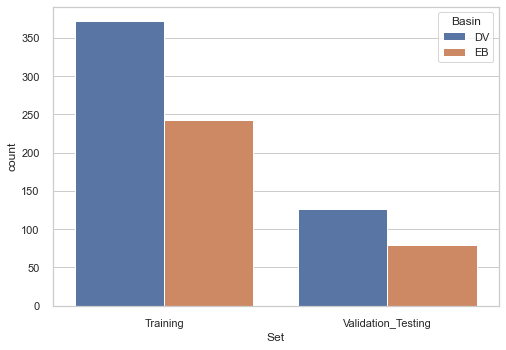

In [578]:
import seaborn as sns
sns.set_theme(style="whitegrid")

ax = sns.countplot(data=Combined3, x="Set", hue="Basin",  order=["Training","Validation_Testing"])

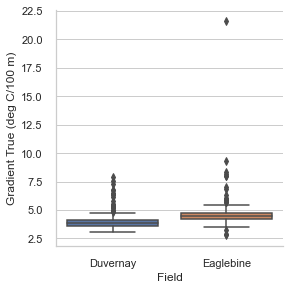

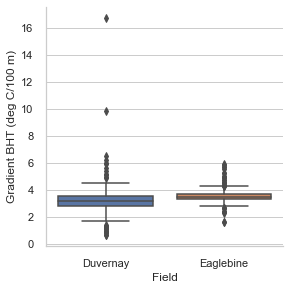

In [579]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.catplot(data=Combined3, x='Field', y='Gradient True (deg C/100 m)',
kind="box", height=4, aspect=1)
           
plt.show()

sns.catplot(data=Combined3, x='Field', y='Gradient BHT (deg C/100 m)',
kind="box", height=4, aspect=1)
           
plt.show()

In [580]:
Combined3.info()
df=Combined3[['UWI','BHT', 'TrueTemp', 'deltaT','Depth_SS(m)','BHT_ subsurface (m)','Gradient True (deg C/100 m)'\
          ,'Gradient BHT (deg C/100 m)','Field']]
df.describe()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 836 entries, 0 to 835
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(281), int64(1), object(63)
memory usage: 2.2+ MB


,BHT,TrueTemp,deltaT,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m)
count,836.000000,615.000000,615.000000,836.000000,836.000000,615.000000,836.000000
mean,74.235776,90.573978,16.298045,1703.487450,2282.771762,4.228937,3.323962
std,29.452182,29.514626,14.948138,1029.084826,853.184945,1.025415,0.849109
min,10.000000,8.370000,-49.922222,-630.950000,225.550000,2.798685,0.654924
25%,51.110000,67.115000,8.460000,866.462500,1680.487500,3.763721,2.967157
50%,72.638889,90.555556,15.390000,1620.625000,2243.533160,4.064093,3.333559
75%,91.111111,110.380000,22.822222,2419.852920,2788.050000,4.494596,3.630303
max,196.111111,196.027778,97.777778,5831.433600,5949.208320,21.615962,16.750166


In [581]:
df.sort_values(by=['Gradient True (deg C/100 m)'],ascending = False).head(3)

,UWI,BHT,TrueTemp,deltaT,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Field
629,42123309360000,42.222222,140.000000,97.777778,647.66952,767.60832,21.615962,5.500490,Eaglebine
628,42123303590000,42.222222,55.061728,12.839506,593.75040,721.27872,9.273548,5.853801,Eaglebine
634,42127000690000,47.777778,57.194444,9.416667,686.07432,911.83968,8.336479,5.239713,Eaglebine


In [582]:
df.sort_values(by=['Gradient BHT (deg C/100 m)'],ascending = False).head(3)

,UWI,BHT,TrueTemp,deltaT,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Field
466,100142904806W500,37.78,8.37,-29.41,-630.95,225.55,3.710929,16.750166,Duvernay
137,100060807808W500,58.90,32.52,-26.38,-66.60,600.50,5.415487,9.808493,Duvernay
473,100152507708W500,40.00,33.32,-6.68,-74.40,612.50,5.440000,6.530612,Duvernay


###### DROP gradient greater than 9.8 degC/100m

In [583]:
Combined3=Combined3.drop(Combined3[Combined3['Gradient True (deg C/100 m)'] > 9.8].index)
Combined3=Combined3.drop(Combined3[Combined3['Gradient BHT (deg C/100 m)'] > 9.8].index)


In [584]:
df2=Combined3[['UWI','BHT', 'TrueTemp', 'Depth_SS(m)','BHT_ subsurface (m)','Gradient True (deg C/100 m)'\
          ,'Gradient BHT (deg C/100 m)','Field']]
df2.sort_values(by=['Gradient BHT (deg C/100 m)'],ascending = False).head(3)

,UWI,BHT,TrueTemp,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Field
473,100152507708W500,40.00,33.32,-74.4,612.5,5.440000,6.530612,Duvernay
341,100102708009W500,34.44,NaN,-97.5,552.6,NaN,6.232356,Duvernay
276,100101007809W500,37.78,32.59,-33.5,629.4,5.177947,6.002542,Duvernay


In [585]:
df2.sort_values(by=['Gradient True (deg C/100 m)'],ascending = False).head(3)

,UWI,BHT,TrueTemp,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m),Field
628,42123303590000,42.222222,55.061728,593.75040,721.27872,9.273548,5.853801,Eaglebine
634,42127000690000,47.777778,57.194444,686.07432,911.83968,8.336479,5.239713,Eaglebine
680,42177305970000,40.000000,45.838889,561.74640,677.08272,8.160068,5.907698,Eaglebine


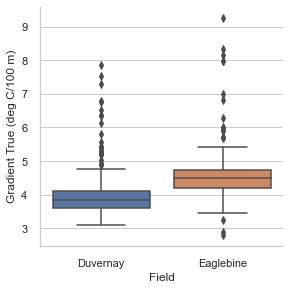

No handles with labels found to put in legend.


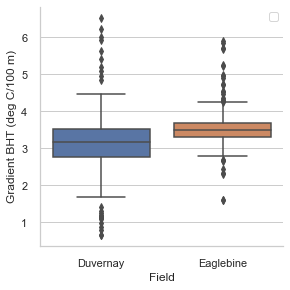

In [620]:
import matplotlib.pyplot as plt
import seaborn as sns
sns.catplot(data=Combined3, x='Field', y='Gradient True (deg C/100 m)',
kind="box", height=4, aspect=1)
           
plt.show()

sns.catplot(data=Combined3, x='Field', y='Gradient BHT (deg C/100 m)',
kind="box", height=4, aspect=1)
plt.legend()
           
plt.show()

In [621]:
filterTraining = Combined3['Set']=='Training'
Combined3[filterTraining].to_csv('training.csv', index=False)

filterTesting = Combined3['Set']=='Validation_Testing'
Combined3[filterTesting].to_csv('val_data_no_label.csv', index=False)

Combined3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 833 entries, 0 to 835
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(281), int64(1), object(63)
memory usage: 2.2+ MB


In [622]:
(np.isnan(Combined3[filterTraining]['BHT'])).sum ()

0

In [623]:
(np.isnan(Combined3[filterTraining]['TrueTemp'])).sum ()

0

In [624]:
(np.isnan(Combined3[filterTesting]['BHT'])).sum ()

0

In [625]:
Combined3.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 833 entries, 0 to 835
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(281), int64(1), object(63)
memory usage: 2.2+ MB


In [626]:
combined_temperature.columns

Index(['UWI', 'BHT', 'TrueTemp', 'deltaT', 'Depth sub-sea (feet)',
       'Depth_SS(m)', 'BHT_ subsurface (ft)', 'BHT_ subsurface (m)', 'GL(ft)',
       'GL(m)', 'Gradient True (deg C/100 m)', 'Gradient BHT (deg C/100 m)',
       'Test Type', 'DST Misrun', 'Formation DSTd', 'diff_depth (m)',
       'TrueTemp_datasource', 'Field', 'TD (ft)',
       'TSC or ORT (time since circulation or original recorded time in hours)'],
      dtype='object')

In [634]:
compare = Combined3.copy(deep=True)

In [806]:
compare['Prod_days']= pd.to_datetime(compare['Last Production Month_0.1']) - pd.to_datetime(compare['First Production Month_0.1'])
compare['Prod_days']=compare['Prod_days'].dt.days
compare['Prod_sec']=compare['Prod_days']*24*60*60


In [807]:
cols_to_move = ['UWI', 'TrueTemp', 'Gradient True (deg C/100 m)','BHT_ subsurface (m)'\
#                , 'Formation DSTd', 'TrueTemp_datasource'\
                ,'Water Total Cum (bbl)_0.1','Oil Total Cum (bbl)_0.1','Gas Total Cum (mcf)_0.1', 'Prod_days', 'Prod_sec']

compare = compare[ cols_to_move + [ col for col in compare.columns if col not in cols_to_move ] ]

In [804]:
compare.head()

,UWI,TrueTemp,Gradient True (deg C/100 m),BHT_ subsurface (m),Water Total Cum (bbl)_0.1,Oil Total Cum (bbl)_0.1,Gas Total Cum (mcf)_0.1,Prod_days,Prod_sec,Formation DSTd,...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
0,100010107020W500,60.97,4.302752,1417.0,NaN,NaN,NaN,NaN,NaN,TRmontney,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
1,100010608109W500,63.98,3.785799,1690.0,390.597,3422.286,2722.761,92.0,7948800.0,Dmuskeg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
2,100010904012W500,NaN,NaN,3708.0,NaN,NaN,NaN,NaN,NaN,Melkton,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,100011206021W400,39.07,4.744384,823.5,NaN,NaN,NaN,NaN,NaN,Dwintrbrn,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
4,100011506915W500,69.47,3.839182,1809.5,NaN,NaN,NaN,NaN,NaN,Dwabamun,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training


In [808]:
filtercompare= compare.loc[(compare['BHT']>=50)]

[(2.0, 10.0), (6000.0, 1000.0)]

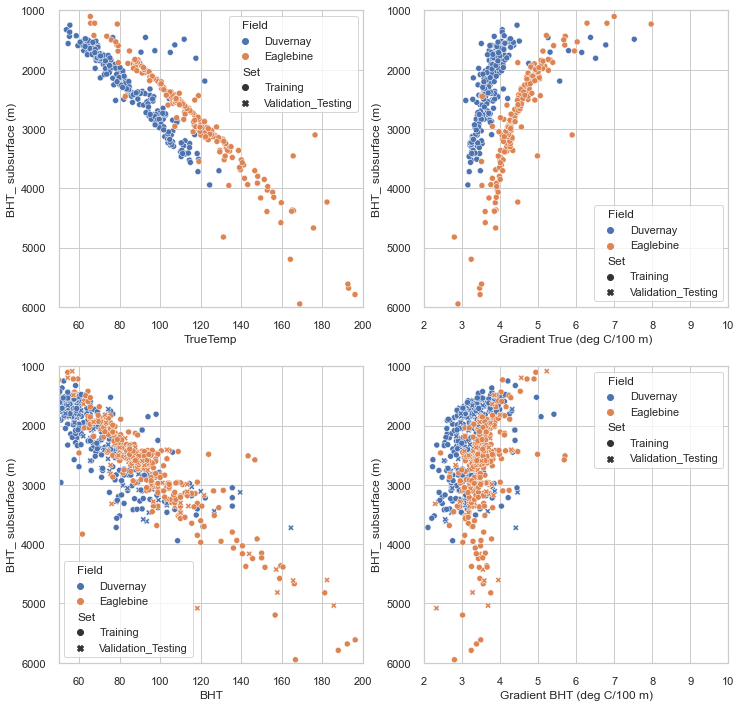

In [809]:
plt.close('all')

fig, axes = plt.subplots(2, 2, sharex=False, figsize=(12,12))

axes[0,0].invert_yaxis()
axes[0,1].invert_yaxis()
axes[1,0].invert_yaxis()
axes[1,1].invert_yaxis()

sns.scatterplot(ax=axes[0,0], data=filtercompare, x="TrueTemp", y="BHT_ subsurface (m)", hue='Field', style = 'Set').set(xlim=(50,200),ylim=(6000,1000))
sns.scatterplot(ax=axes[1,0], data=filtercompare, x="BHT", y="BHT_ subsurface (m)", hue='Field', style = 'Set').set(xlim=(50,200),ylim=(6000,1000))

sns.scatterplot(ax=axes[0,1], data=filtercompare, x="Gradient True (deg C/100 m)", y="BHT_ subsurface (m)", hue='Field', style = 'Set').set(xlim=(2,10),ylim=(6000,1000))
sns.scatterplot(ax=axes[1,1], data=filtercompare, x="Gradient BHT (deg C/100 m)", y="BHT_ subsurface (m)", hue='Field', style = 'Set').set(xlim=(2,10),ylim=(6000,1000))

In [810]:
Summary= filtercompare[['UWI', 'BHT', 'TrueTemp', 'Depth_SS(m)', 'BHT_ subsurface (m)', 
       'Gradient True (deg C/100 m)', 'Gradient BHT (deg C/100 m)', 'Field']]
Forstatsd = Summary.loc[(Summary['Field'] == 'Duvernay')]
Forstatsd.describe()

,BHT,TrueTemp,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m)
count,322.000000,236.000000,322.000000,322.000000,236.000000,322.000000
mean,73.766522,84.699939,1430.201708,2325.123758,3.823126,3.237774
std,19.494887,17.201605,615.234582,665.466456,0.566875,0.517510
min,50.000000,53.790000,384.600000,1248.500000,3.099903,1.726106
25%,58.890000,69.325000,930.087500,1749.300000,3.509576,2.900563
50%,69.000000,81.590000,1296.175000,2193.425000,3.747629,3.222530
75%,84.380000,99.540000,1889.100000,2829.575000,3.953604,3.518087
max,164.440000,128.980000,3624.600000,5128.200000,7.527823,5.416759


In [811]:
Summary= filtercompare[['UWI', 'BHT', 'TrueTemp', 'Depth_SS(m)', 'BHT_ subsurface (m)', 
       'Gradient True (deg C/100 m)', 'Gradient BHT (deg C/100 m)', 'Field']]
Forstatse = Summary.loc[(Summary['Field'] == 'Eaglebine')]
Forstatse.describe()

,BHT,TrueTemp,Depth_SS(m),BHT_ subsurface (m),Gradient True (deg C/100 m),Gradient BHT (deg C/100 m)
count,318.000000,237.000000,318.000000,318.000000,237.000000,318.000000
mean,95.937107,115.315800,2630.170345,2764.283534,4.500539,3.521740
std,25.517928,22.850791,801.764097,790.493432,0.577898,0.429976
min,50.000000,65.555556,936.650400,1083.685920,2.798685,1.609739
25%,80.138889,103.016667,2228.240400,2371.618320,4.202520,3.293801
50%,91.111111,111.883333,2486.314560,2605.704720,4.478075,3.478910
75%,104.861111,125.338889,2957.382960,3090.946320,4.682544,3.673256
max,196.111111,196.027778,5831.433600,5949.208320,7.972334,5.708071


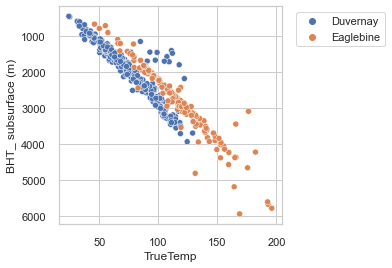

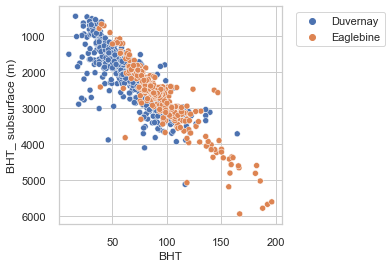

In [812]:
plt.close('all')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=Combined3, 
                x="TrueTemp",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

fig, ax = plt.subplots(1, 1, figsize=(4,4))
sns.scatterplot(data=Combined3, 
                x="BHT",
                y="BHT_ subsurface (m)",
                hue='Field', ax=ax)
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")
plt.grid(b=None, which='major', axis='both')

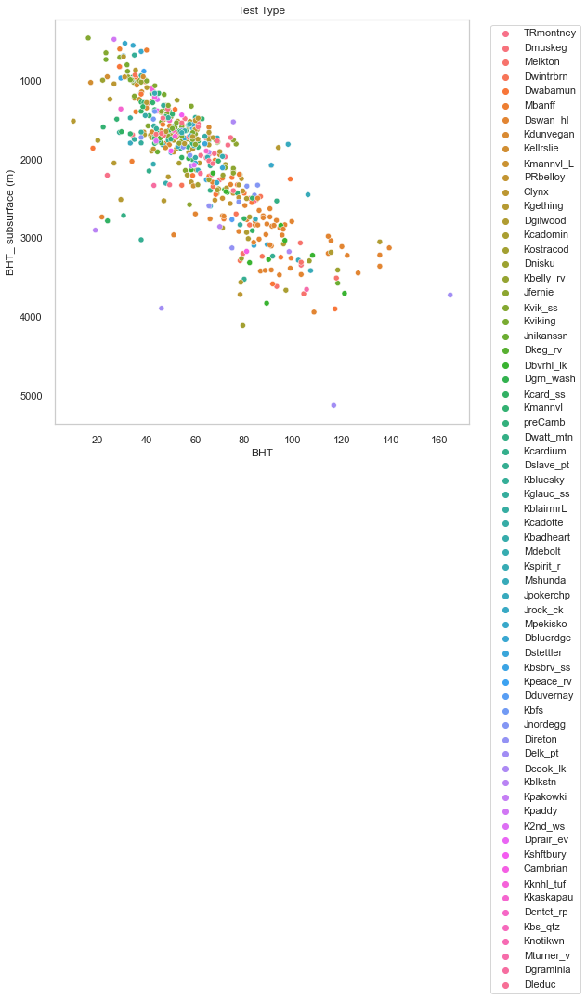

In [813]:
ForPlot = Combined3.loc[(Combined3['Field'] == 'Duvernay')]

plt.close('all')

fig, ax = plt.subplots(1, 1, figsize=(8,8))
sns.scatterplot(data=ForPlot, 
                x="BHT",
                y="BHT_ subsurface (m)",
                hue='Formation DSTd', ax=ax)
plt.title('Test Type')
plt.grid(b=None, which='major', axis='both')
plt.gca().invert_yaxis()
plt.legend(bbox_to_anchor=(1.04,1), loc="upper left")


# hotter / shallow (lower capital/op cost) well/area/formation to look into

In [814]:
Dhot= compare.loc[(compare['Field'] == 'Duvernay') & (compare['Gradient True (deg C/100 m)'] > 4.5) & (compare['TrueTemp'] > 40)]

In [820]:
cols_to_move = ['UWI', 'TrueTemp', 'Gradient True (deg C/100 m)','BHT_ subsurface (m)'\
                , 'Formation DSTd', 'TrueTemp_datasource'\
                ,'Water Total Cum (bbl)_0.1','Oil Total Cum (bbl)_0.1','Gas Total Cum (mcf)_0.1', 'Prod_days']

Dhot = Dhot[ cols_to_move + [ col for col in Dhot.columns if col not in cols_to_move ] ]
Dhot.sort_values('Gradient True (deg C/100 m)', ascending=False).head(15)

,UWI,TrueTemp,Gradient True (deg C/100 m),BHT_ subsurface (m),Formation DSTd,TrueTemp_datasource,Water Total Cum (bbl)_0.1,Oil Total Cum (bbl)_0.1,Gas Total Cum (mcf)_0.1,Prod_days,...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
47,100022806419W500,111.055556,7.864567,1412.10,Kmannvl,static_temp_logs,1.324195e+07,5857766.213,7.174252e+06,18840.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
423,100120906419W500,111.833333,7.527823,1485.60,Kmannvl,static_temp_logs,1.941306e+06,1604781.066,1.882187e+06,20728.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
355,100103206321W500,84.700000,7.304243,1159.60,Kcard_ss,static_temp_logs,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
337,100102606619W500,107.222222,6.779351,1581.60,Jfernie,static_temp_logs,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
414,100113306020W500,98.888889,6.758399,1463.20,Kcard_ss,static_temp_logs,2.258040e+02,0.000,7.944635e+05,2892.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
44,100022706319W500,117.611111,6.512604,1805.90,Jfernie,static_temp_logs,1.536839e+06,557537.002,8.092497e+05,11232.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
113,100050506418W500,92.777778,6.378014,1454.65,Kcadotte,static_temp_logs,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
441,100123506419W500,109.111111,6.331522,1723.30,Jnordegg,static_temp_logs,5.830903e+06,4200386.593,5.910422e+06,16802.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
503,102061504716W500,105.000000,6.147721,1707.95,Kknhl_tuf,static_temp_logs,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
360,100103406419W500,97.388889,5.801620,1678.65,Jfernie,static_temp_logs,0.000000e+00,101793.669,9.273278e+04,1096.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training


In [817]:
D3d = compare.loc[(compare['Field'] == 'Duvernay')]

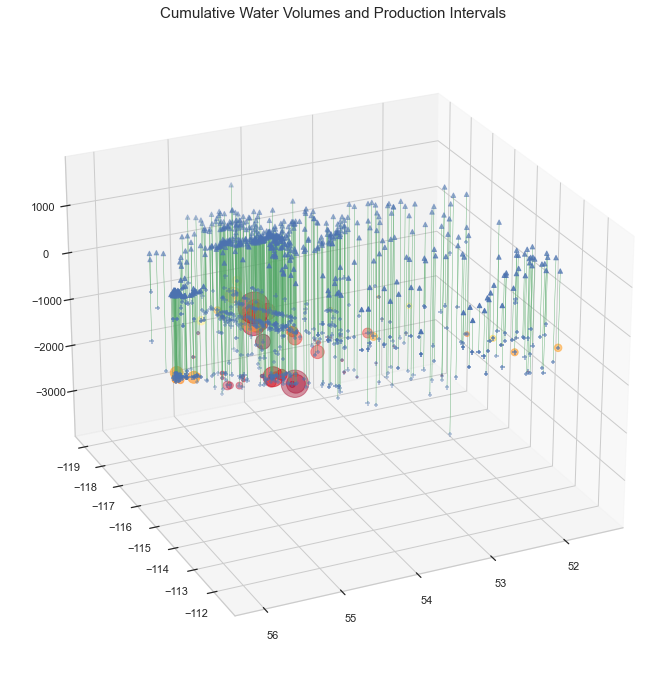

In [818]:
TopLon=D3d["SurfaceLatitude_NAD83_0.1"]
TopLat=D3d["SurfaceLongitude_NAD83_0.1"]
TopEle=D3d["GL(m)"]

BotLon=D3d["BottomLatitude_NAD83_0.1"]
BotLat=D3d["BottomLongitude_NAD83_0.1"]
BotEle=TopEle-D3d["BHT_ subsurface (m)"]

DSTLon=D3d["SurfaceLatitude_NAD83_0"]
DSTLat=D3d["SurfaceLongitude_NAD83_0"]
DSTEle=TopEle-D3d["BHT_ subsurface (m)"]

fig = plt.figure(figsize=(12,12))

ax = fig.add_subplot(111, projection='3d')

for tlo,tla,te,blo,bla,be in zip(TopLon,TopLat,TopEle,BotLon,BotLat,BotEle):
    ax.plot([tlo,blo],[tla,bla],[te,be],lw=0.4,color = 'g')
    


ax.scatter(TopLon, TopLat, TopEle, color = 'b', marker = "^")
ax.scatter(BotLon, BotLat, BotEle, color = 'b', marker = "+")
close = D3d["TrueTemp"]
volume = (D3d["Water Total Cum (bbl)_0.1"]+D3d["Oil Total Cum (bbl)_0.1"])/D3d['Prod_days']
#volume = (D3d["Water Total Cum (bbl)_0.1"])/D3d['Prod_days']
# true temperature at DST location
# ax.scatter(DSTLon, DSTLat, DSTEle, c=close, cmap = 'YlOrRd', marker = "o")
# true temperature at total depth location
ax.scatter(BotLon, BotLat, BotEle, c=close, cmap = 'YlOrRd', marker = "o", s= volume)

ax.set_title("Cumulative Water Volumes and Production Intervals", fontsize=15)
ax.view_init(25, 65)
plt.show()

### Temperature maps

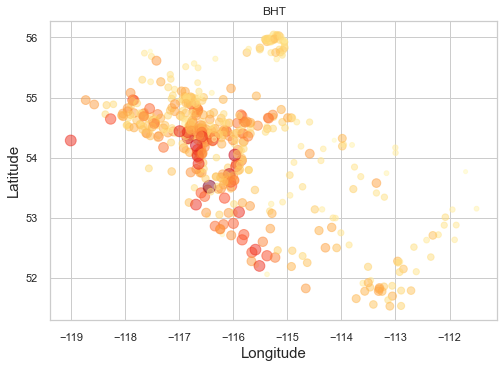

In [678]:
# plot Duvernay "heatmap" of measured temperatures on surface coordinates
DTempPlot = Combined3.loc[(Combined3['Field'] == 'Duvernay')]

x = DTempPlot["SurfaceLongitude_NAD83_0.1"]
y = DTempPlot["SurfaceLatitude_NAD83_0.1"]
# Marker size in units of points^2
volume = DTempPlot["BHT"]
close = DTempPlot["BHT"]

fig, ax = plt.subplots()
ax.scatter(x, y, c=close, s=volume, cmap="YlOrRd", alpha=0.5)

ax.set_xlabel("Longitude", fontsize=15)
ax.set_ylabel("Latitude", fontsize=15)
ax.set_title("BHT")

ax.grid(True)

plt.show()

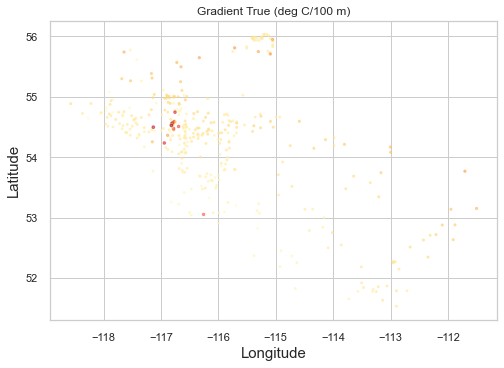

In [712]:
# plot Duvernay "heatmap" of measured temperatures on surface coordinates
DTempPlot = Combined3.loc[(Combined3['Field'] == 'Duvernay')]

x = DTempPlot["SurfaceLongitude_NAD83_0.1"]
y = DTempPlot["SurfaceLatitude_NAD83_0.1"]
# Marker size in units of points^2
volume = DTempPlot["Gradient True (deg C/100 m)"]
close = DTempPlot["Gradient True (deg C/100 m)"]

fig, ax = plt.subplots()
ax.scatter(x, y, c=close, s=volume, cmap="YlOrRd", alpha=0.5)

ax.set_xlabel("Longitude", fontsize=15)
ax.set_ylabel("Latitude", fontsize=15)
ax.set_title("Gradient True (deg C/100 m)")

ax.grid(True)

plt.show()

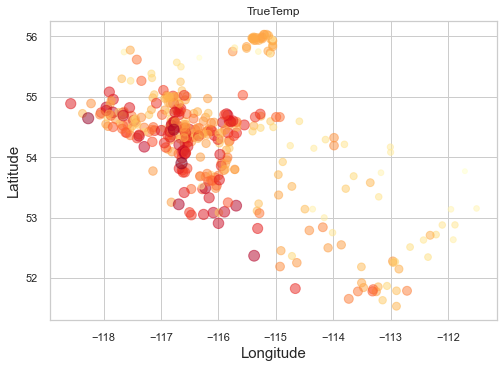

In [713]:
# plot Duvernay "heatmap" of measured temperatures on surface coordinates
DTempPlot = Combined3.loc[(Combined3['Field'] == 'Duvernay')]

x = DTempPlot["SurfaceLongitude_NAD83_0.1"]
y = DTempPlot["SurfaceLatitude_NAD83_0.1"]
# Marker size in units of points^2
volume = DTempPlot["TrueTemp"]
close = DTempPlot["TrueTemp"]

fig, ax = plt.subplots()
ax.scatter(x, y, c=close, s=volume, cmap="YlOrRd", alpha=0.5)

ax.set_xlabel("Longitude", fontsize=15)
ax.set_ylabel("Latitude", fontsize=15)
ax.set_title("TrueTemp")

ax.grid(True)

plt.show()

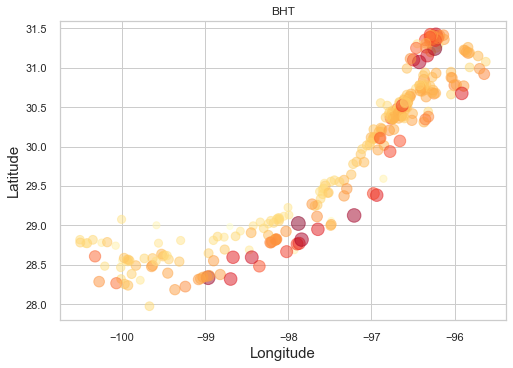

In [680]:
# plot Eaglebine "heatmap" of measured temperatures on surface coordinates
ETempPlot = Combined3.loc[(Combined3['Field'] == 'Eaglebine')]

x = ETempPlot["SurfaceLongitude_NAD83_0"]
y = ETempPlot["SurfaceLatitude_NAD83_0"]
# Marker size in units of points^2
volume = ETempPlot["BHT"]
close = ETempPlot["BHT"]

fig, ax = plt.subplots()
ax.scatter(x, y, c=close, s=volume, cmap="YlOrRd", alpha=0.5)

ax.set_xlabel("Longitude", fontsize=15)
ax.set_ylabel("Latitude", fontsize=15)
ax.set_title("BHT")

ax.grid(True)

plt.show()

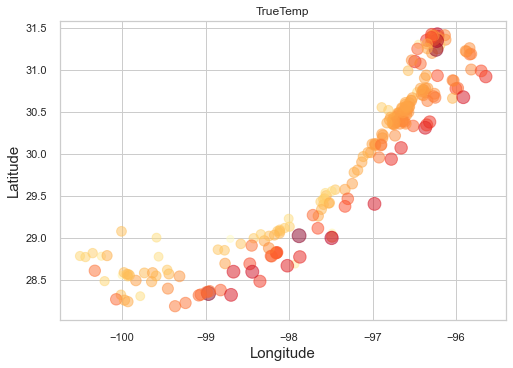

In [681]:
# plot Eaglebine "heatmap" of measured temperatures on surface coordinates
ETempPlot = Combined3.loc[(Combined3['Field'] == 'Eaglebine')]

x = ETempPlot["SurfaceLongitude_NAD83_0"]
y = ETempPlot["SurfaceLatitude_NAD83_0"]
# Marker size in units of points^2
volume = ETempPlot["TrueTemp"]
close = ETempPlot["TrueTemp"]

fig, ax = plt.subplots()
ax.scatter(x, y, c=close, s=volume, cmap="YlOrRd", alpha=0.5)

ax.set_xlabel("Longitude", fontsize=15)
ax.set_ylabel("Latitude", fontsize=15)
ax.set_title("TrueTemp")

ax.grid(True)

plt.show()

### Production

In [719]:
# read in the production data and use max production rates as flow indicators
EagPrd = pd.read_excel(dir_eaglebine+"EagleBine Casing production summary for SPE April21 2020.xlsx")
EagPrd["UWI"]=EagPrd["UWI"].astype("str")
EagPrd["UWI"]=EagPrd["UWI"]+"0000"
EagPrd.head()

,UWI,MinCasingSize\,spuddate,completiondate,cumoil,cumgas,cumwater
0,42013301930000,5.500,NaN,1972-07-22,6140.000,8702967.000,1002330.677
1,42013302760000,4.500,NaN,1975-07-28,1929.332,7.992,0.000
2,42013305480000,2.875,1977-01-23,1977-02-24,0.000,10067.000,0.000
3,42013311740000,2.375,1981-04-28,1981-06-11,3697.000,5679789.000,37521.613
4,42013313140000,2.375,NaN,1982-04-20,69.000,2.000,0.000


In [720]:
# need to check the other prodcution file for time on production
EagPrdTime = pd.read_excel(dir_eaglebine+"SPE Eaglebine production summary April 20 2021.xlsx")

EagPrdTime.head()

,API,Measured Depth (ft),Total Vertical Depth (ft),Spud Date,Completion Date,First Production Month,Elevation,Oil Total Cum (bbl),Gas Total Cum (mcf),Water Total Cum (bbl),...,Drilling Days,Last Production Month,Gas Maximum (mcf),Gas Maximum Date,Oil Maximum (bbl),Oil Maximum Date,Water Maximum (bbl),Water Maximum Date,Liquid Injection Cum (bbl),Gas Injection Cum (mcf)
0,42013301410000,NaN,NaN,1971-02-14,NaT,NaT,NaN,NaN,NaN,NaN,...,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaN
1,42013301930000,NaN,10775.0,NaT,1972-07-22,1972-07-01,363 GL,6140.000,8702967.000,1002330.677,...,NaN,2020-12-01,98093.000,1972-10-01,271.000,2010-03-01,11771.16,1972-10-01,NaN,NaN
2,42013302760000,NaN,6168.0,NaT,1975-07-28,1975-07-01,409 GL,1929.332,7.992,0.000,...,NaN,1981-02-01,0.333,1975-07-01,533.333,1975-08-01,0.00,1975-07-01,NaN,NaN
3,42013305480000,NaN,NaN,1977-01-23,1977-02-24,1977-02-01,267 GL,0.000,10067.000,0.000,...,NaN,1979-08-01,1464.000,1977-04-01,0.000,1977-02-01,0.00,1977-02-01,NaN,NaN
4,42013310190000,NaN,11000.0,1980-08-13,1980-10-25,1980-11-01,NaN,4424.000,6610808.000,47611.388,...,NaN,2020-12-01,63674.000,1981-08-01,108.000,1992-10-01,870.74,1998-05-01,NaN,NaN


In [721]:
EagPrdTime["UWI"]=EagPrdTime["API   "].astype("str")

In [722]:
EagPrdTime.rename(columns={"First Production Month   ":"MthOn","Oil Total Cum (bbl)   ":"TotOil",
                           'Gas Total Cum (mcf)   ':"TotGas", 'Water Total Cum (bbl)   ':"TotWtr",
                           'Last Production Month   ':"MthOff"},inplace=True)

EagPrdTime.head()

,API,Measured Depth (ft),Total Vertical Depth (ft),Spud Date,Completion Date,MthOn,Elevation,TotOil,TotGas,TotWtr,...,MthOff,Gas Maximum (mcf),Gas Maximum Date,Oil Maximum (bbl),Oil Maximum Date,Water Maximum (bbl),Water Maximum Date,Liquid Injection Cum (bbl),Gas Injection Cum (mcf),UWI
0,42013301410000,NaN,NaN,1971-02-14,NaT,NaT,NaN,NaN,NaN,NaN,...,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaN,42013301410000
1,42013301930000,NaN,10775.0,NaT,1972-07-22,1972-07-01,363 GL,6140.000,8702967.000,1002330.677,...,2020-12-01,98093.000,1972-10-01,271.000,2010-03-01,11771.16,1972-10-01,NaN,NaN,42013301930000
2,42013302760000,NaN,6168.0,NaT,1975-07-28,1975-07-01,409 GL,1929.332,7.992,0.000,...,1981-02-01,0.333,1975-07-01,533.333,1975-08-01,0.00,1975-07-01,NaN,NaN,42013302760000
3,42013305480000,NaN,NaN,1977-01-23,1977-02-24,1977-02-01,267 GL,0.000,10067.000,0.000,...,1979-08-01,1464.000,1977-04-01,0.000,1977-02-01,0.00,1977-02-01,NaN,NaN,42013305480000
4,42013310190000,NaN,11000.0,1980-08-13,1980-10-25,1980-11-01,NaN,4424.000,6610808.000,47611.388,...,2020-12-01,63674.000,1981-08-01,108.000,1992-10-01,870.74,1998-05-01,NaN,NaN,42013310190000


In [723]:
EagPrdTime["Diff"]=EagPrdTime["MthOff"]-EagPrdTime["MthOn"]

In [724]:
cols_to_move = ['UWI', 'TotOil', 'TotGas', 'TotWtr', 'Diff']
EagPrdTime = EagPrdTime[ cols_to_move + [ col for col in EagPrdTime.columns if col not in cols_to_move ] ]
EagPrdTime.head()

,UWI,TotOil,TotGas,TotWtr,Diff,API,Measured Depth (ft),Total Vertical Depth (ft),Spud Date,Completion Date,...,Drilling Days,MthOff,Gas Maximum (mcf),Gas Maximum Date,Oil Maximum (bbl),Oil Maximum Date,Water Maximum (bbl),Water Maximum Date,Liquid Injection Cum (bbl),Gas Injection Cum (mcf)
0,42013301410000,NaN,NaN,NaN,NaT,42013301410000,NaN,NaN,1971-02-14,NaT,...,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaT,NaN,NaN
1,42013301930000,6140.000,8702967.000,1002330.677,17685 days,42013301930000,NaN,10775.0,NaT,1972-07-22,...,NaN,2020-12-01,98093.000,1972-10-01,271.000,2010-03-01,11771.16,1972-10-01,NaN,NaN
2,42013302760000,1929.332,7.992,0.000,2042 days,42013302760000,NaN,6168.0,NaT,1975-07-28,...,NaN,1981-02-01,0.333,1975-07-01,533.333,1975-08-01,0.00,1975-07-01,NaN,NaN
3,42013305480000,0.000,10067.000,0.000,911 days,42013305480000,NaN,NaN,1977-01-23,1977-02-24,...,NaN,1979-08-01,1464.000,1977-04-01,0.000,1977-02-01,0.00,1977-02-01,NaN,NaN
4,42013310190000,4424.000,6610808.000,47611.388,14640 days,42013310190000,NaN,11000.0,1980-08-13,1980-10-25,...,NaN,2020-12-01,63674.000,1981-08-01,108.000,1992-10-01,870.74,1998-05-01,NaN,NaN


In [725]:
EagPrdTime["Diff"] = EagPrdTime["Diff"].dt.days

In [726]:
Grouped= EagPrdTime.groupby("UWI").sum()
EagPrdTime=Grouped.reset_index()
print(EagPrdTime.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 308 entries, 0 to 307
Data columns (total 15 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   UWI                            308 non-null    object 
 1   TotOil                         308 non-null    float64
 2   TotGas                         308 non-null    float64
 3   TotWtr                         308 non-null    float64
 4   Diff                           308 non-null    float64
 5   API                            308 non-null    int64  
 6   Measured Depth (ft)            308 non-null    float64
 7   Total Vertical Depth (ft)      308 non-null    float64
 8   GOR Total Average              308 non-null    float64
 9   Drilling Days                  308 non-null    float64
 10  Gas Maximum (mcf)              308 non-null    float64
 11  Oil Maximum (bbl)              308 non-null    float64
 12  Water Maximum (bbl)            308 non-null    flo

In [727]:
EagPrdData = pd.merge(EagPrd,EagData,on="UWI")
EagPrdData.head()

,UWI,MinCasingSize\,spuddate,completiondate,cumoil,cumgas,cumwater,Unnamed: 0_x,BHT,TrueTemp,...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
0,42013301930000,5.500,NaN,1972-07-22,6140.000,8702967.000,1002330.677,1,107.222222,132.778000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
1,42013302760000,4.500,NaN,1975-07-28,1929.332,7.992,0.000,2,65.555556,89.161111,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
2,42013305480000,2.875,1977-01-23,1977-02-24,0.000,10067.000,0.000,3,76.666667,107.961111,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
3,42013311740000,2.375,1981-04-28,1981-06-11,3697.000,5679789.000,37521.613,5,118.333333,132.566667,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
4,42013313140000,2.375,NaN,1982-04-20,69.000,2.000,0.000,7,85.000000,111.672222,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training


In [728]:
# and then merge it all together and check all numbers

EagPrd = pd.merge(EagPrd,EagPrdTime,on="UWI", sort=False)

EagPrd

# looks okay

,UWI,MinCasingSize\,spuddate,completiondate,cumoil,cumgas,cumwater,TotOil,TotGas,TotWtr,...,API,Measured Depth (ft),Total Vertical Depth (ft),GOR Total Average,Drilling Days,Gas Maximum (mcf),Oil Maximum (bbl),Water Maximum (bbl),Liquid Injection Cum (bbl),Gas Injection Cum (mcf)
0,42013301930000,5.500,NaN,1972-07-22,6140.000,8702967.000,1002330.677,6140.000,8702967.000,1002330.677,...,42013301930000,0.0,10775.0,1417421.336,0.0,98093.000,271.000,11771.160,0.0,0.0
1,42013302760000,4.500,NaN,1975-07-28,1929.332,7.992,0.000,1929.332,7.992,0.000,...,42013302760000,0.0,6168.0,4.142,0.0,0.333,533.333,0.000,0.0,0.0
2,42013305480000,2.875,1977-01-23,1977-02-24,0.000,10067.000,0.000,0.000,10067.000,0.000,...,42013305480000,0.0,0.0,0.000,0.0,1464.000,0.000,0.000,0.0,0.0
3,42013311740000,2.375,1981-04-28,1981-06-11,3697.000,5679789.000,37521.613,3697.000,5679789.000,37521.613,...,42013311740000,0.0,10956.0,1536323.776,0.0,55767.000,110.000,334.602,0.0,0.0
4,42013313140000,2.375,NaN,1982-04-20,69.000,2.000,0.000,69.000,2.000,0.000,...,42013313140000,0.0,0.0,28.986,0.0,1.000,53.000,0.000,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
255,42493317790000,4.500,NaN,1985-09-06,36228.000,1065.000,0.000,36228.000,1065.000,0.000,...,42493317790000,0.0,6428.0,29.397,0.0,140.000,2801.000,0.000,0.0,0.0
256,42493318190000,4.500,1985-11-26,1985-12-04,463.000,5.000,0.000,463.000,5.000,0.000,...,42493318190000,0.0,6919.0,10.799,0.0,1.000,278.000,0.000,0.0,0.0
257,42493319370000,4.500,NaN,1986-09-18,90664.817,25922.736,27306.577,90664.817,25922.736,27306.577,...,84986638740000,17004.0,14160.0,455.766,0.0,1544.001,4103.684,2757.006,0.0,0.0
258,42507312420000,2.375,1979-10-11,1980-01-28,0.000,3037.000,0.000,0.000,3037.000,0.000,...,85014624840000,0.0,20140.0,0.000,0.0,2000.000,0.000,0.000,0.0,0.0


In [729]:
Combined3copy = Combined3.copy(deep=True)

In [730]:
# Eaglebine
EagData = Combined3copy.loc[(Combined3copy['Field'] == 'Eaglebine')]
EagPrdData = pd.merge(EagPrd,EagData,on="UWI")

In [731]:
EagPrdData

,UWI,MinCasingSize\,spuddate,completiondate,cumoil,cumgas,cumwater,TotOil,TotGas,TotWtr,...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
0,42013301930000,5.500,NaN,1972-07-22,6140.000,8702967.000,1002330.677,6140.000,8702967.000,1002330.677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
1,42013302760000,4.500,NaN,1975-07-28,1929.332,7.992,0.000,1929.332,7.992,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
2,42013305480000,2.875,1977-01-23,1977-02-24,0.000,10067.000,0.000,0.000,10067.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
3,42013311740000,2.375,1981-04-28,1981-06-11,3697.000,5679789.000,37521.613,3697.000,5679789.000,37521.613,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
4,42013313140000,2.375,NaN,1982-04-20,69.000,2.000,0.000,69.000,2.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
254,42493317790000,4.500,NaN,1985-09-06,36228.000,1065.000,0.000,36228.000,1065.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
255,42493318190000,4.500,1985-11-26,1985-12-04,463.000,5.000,0.000,463.000,5.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
256,42493319370000,4.500,NaN,1986-09-18,90664.817,25922.736,27306.577,90664.817,25922.736,27306.577,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
257,42507312420000,2.375,1979-10-11,1980-01-28,0.000,3037.000,0.000,0.000,3037.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing


In [732]:
# make an estimate on average geothermal potential
# 𝑃𝑇 = 𝑄 ∗ 𝜌 ∗ 𝐶𝑤 ∗ ∆𝑇 
# potential in MW, with flow rate Q in m3/s, density of water at bottomhole conditions
# heat capacity of water at bottom hole conditions, and temperature difference between
# water injected (say some 20 oC) and water produced (assume bottom hole formation (i.e DST) temperature)
EagPrdData["AvgFlow"]=0.0
EagPrdData["GTPot"]=0.0

In [733]:
EagPrdData.columns

Index(['UWI', 'MinCasingSize\', 'spuddate', 'completiondate', 'cumoil',
       'cumgas', 'cumwater', 'TotOil', 'TotGas', 'TotWtr',
       ...
       '22200.0_GRWS', '22500.0_GRWS', '22800.0_GRWS', '23100.0_GRWS',
       '23400.0_GRWS', '23700.0_GRWS', '24000.0_GRWS', 'Set', 'AvgFlow',
       'GTPot'],
      dtype='object', length=367)

In [734]:
# barrel to m3: / 6.2898
# mcf to m3: * 28.316846592

In [735]:
EagPrdData.to_csv('EagPrdData.csv')

In [736]:
timeon = 0.0
cumoil = 0.0
cumwtr = 0.0
cumgas = 0.0
density = 0.0
capacity = 0.0
temprock = 0.0
tempin = 0.0
rteavg = 0.0
potential = 0.0

for wellname in EagPrdData["UWI"]:
    timeon = EagPrdData.loc[EagPrdData['UWI']==wellname,"Diff"].item() * 24 * 60 * 60
    cumoil = EagPrdData.loc[EagPrdData['UWI']==wellname,"TotOil"].item() 
    cumwtr = EagPrdData.loc[EagPrdData['UWI']==wellname,"TotWtr"].item()
    cumgas = EagPrdData.loc[EagPrdData['UWI']==wellname,"TotGas"].item()
    density = 1000.0
    capacity = 3.9
    temprock = EagPrdData.loc[EagPrdData['UWI']==wellname,"TrueTemp"].item()
    tempin = 90.0
    rteavg = (cumoil/6.2898 + cumwtr/6.2898 + cumgas*28.316846592)
#    display(rteavg)
#    display(timeon)
    if timeon != 0:
        rteavg = rteavg  / timeon
    else:
        rteavg = 0.0
    
    EagPrdData.loc[EagPrdData['UWI']==wellname,"AvgFlow"] = rteavg
    potential = rteavg*density*capacity*(temprock-tempin)
    if (potential > 0) & (potential < 1e5):
        potential = potential
    elif potential > 1e6:
        potential = 1e6
    else:
        potential = 0.0
        
    EagPrdData.loc[EagPrdData['UWI']==wellname,"GTPot"] = potential
        
      

In [737]:
EagPrdData.head(5)

,UWI,MinCasingSize\,spuddate,completiondate,cumoil,cumgas,cumwater,TotOil,TotGas,TotWtr,...,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set,AvgFlow,GTPot
0,42013301930000,5.500,NaN,1972-07-22,6140.000,8702967.000,1002330.677,6140.000,8702967.000,1002330.677,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training,0.161390,26925.325459
1,42013302760000,4.500,NaN,1975-07-28,1929.332,7.992,0.000,1929.332,7.992,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training,0.000003,0.000000
2,42013305480000,2.875,1977-01-23,1977-02-24,0.000,10067.000,0.000,0.000,10067.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training,0.003622,253.694261
3,42013311740000,2.375,1981-04-28,1981-06-11,3697.000,5679789.000,37521.613,3697.000,5679789.000,37521.613,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training,0.129573,21510.435381
4,42013313140000,2.375,NaN,1982-04-20,69.000,2.000,0.000,69.000,2.000,0.000,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training,0.000026,2.204471


In [738]:
EagPrdData["GTPot"].max()

90160.90954431593

In [739]:
EagPrdData.to_csv('EagPrdData.csv')

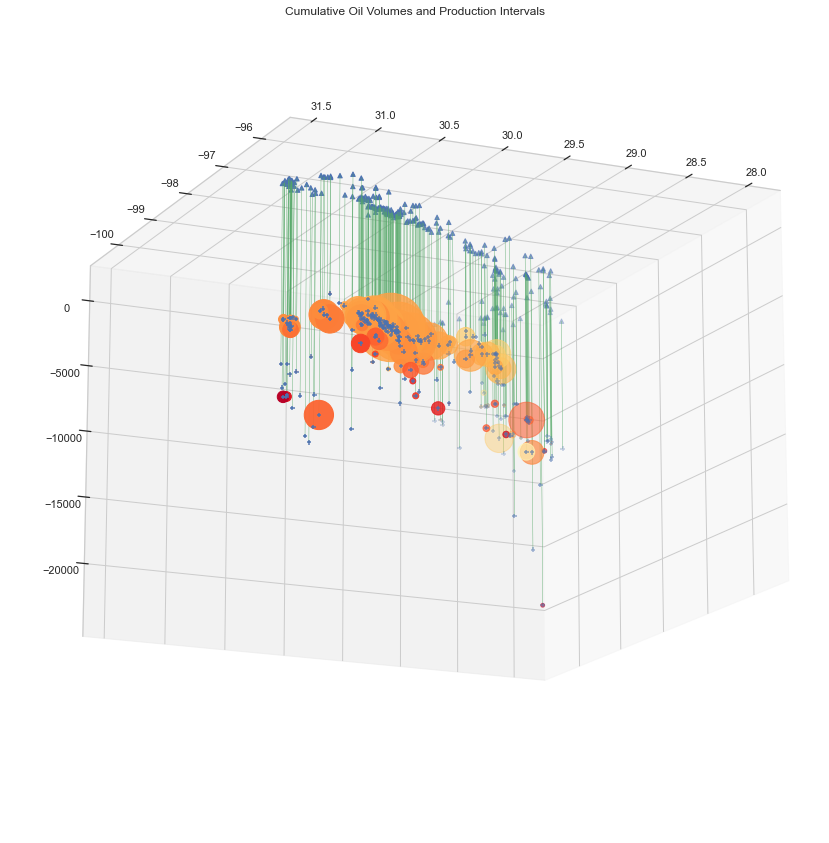

In [740]:
TopLon=EagPrdData["SurfaceLatitude_NAD83_0"]
TopLat=EagPrdData["SurfaceLongitude_NAD83_0"]
TopEle=EagPrdData["GL(ft)"]

BotLon=EagPrdData["BottomLatitude_NAD83_0"]
BotLat=EagPrdData["BottomLongitude_NAD83_0"]
BotEle=TopEle-EagPrdData["TD (ft)"]

DSTLon=EagPrdData["SurfaceLatitude_NAD83_0"]
DSTLat=EagPrdData["SurfaceLongitude_NAD83_0"]
DSTEle=TopEle-EagPrdData["BHT_ subsurface (ft)"]

fig = plt.figure(figsize=(15,15))

ax = fig.add_subplot(111, projection='3d')

for tlo,tla,te,blo,bla,be in zip(TopLon,TopLat,TopEle,BotLon,BotLat,BotEle):
    ax.plot([tlo,blo],[tla,bla],[te,be],lw=0.4,color = 'g')
    


ax.scatter(TopLon, TopLat, TopEle, color = 'b', marker = "^")
ax.scatter(BotLon, BotLat, BotEle, color = 'b', marker = "+")
close = EagPrdData["TrueTemp"]
volume = EagPrdData["TotOil"]/100
# true temperature at DST location
# ax.scatter(DSTLon, DSTLat, DSTEle, c=close, cmap = 'YlOrRd', marker = "o")
# true temperature at total depth location
ax.scatter(BotLon, BotLat, BotEle, c=close, cmap = 'YlOrRd', marker = "o", s= volume)

ax.set_title("Cumulative Oil Volumes and Production Intervals")
ax.view_init(-15, 65)
plt.show()

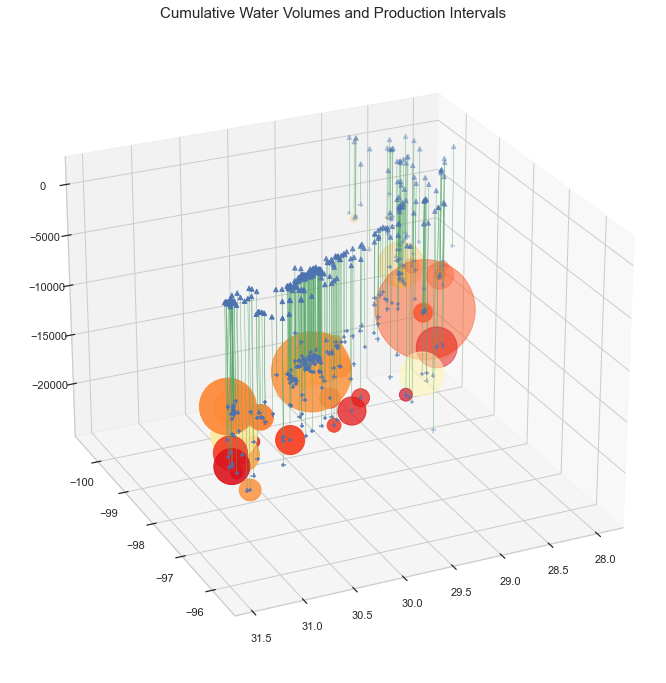

In [741]:
TopLon=EagPrdData["SurfaceLatitude_NAD83_0"]
TopLat=EagPrdData["SurfaceLongitude_NAD83_0"]
TopEle=EagPrdData["GL(ft)"]

BotLon=EagPrdData["BottomLatitude_NAD83_0"]
BotLat=EagPrdData["BottomLongitude_NAD83_0"]
BotEle=TopEle-EagPrdData["TD (ft)"]

DSTLon=EagPrdData["SurfaceLatitude_NAD83_0"]
DSTLat=EagPrdData["SurfaceLongitude_NAD83_0"]
DSTEle=TopEle-EagPrdData["BHT_ subsurface (ft)"]

fig = plt.figure(figsize=(12,12))

ax = fig.add_subplot(111, projection='3d')

for tlo,tla,te,blo,bla,be in zip(TopLon,TopLat,TopEle,BotLon,BotLat,BotEle):
    ax.plot([tlo,blo],[tla,bla],[te,be],lw=0.4,color = 'g')
    


ax.scatter(TopLon, TopLat, TopEle, color = 'b', marker = "^")
ax.scatter(BotLon, BotLat, BotEle, color = 'b', marker = "+")
close = EagPrdData["TrueTemp"]
volume = EagPrdData["TotWtr"]/100
# true temperature at DST location
# ax.scatter(DSTLon, DSTLat, DSTEle, c=close, cmap = 'YlOrRd', marker = "o")
# true temperature at total depth location
ax.scatter(BotLon, BotLat, BotEle, c=close, cmap = 'YlOrRd', marker = "o", s= volume)

ax.set_title("Cumulative Water Volumes and Production Intervals", fontsize=15)
ax.view_init(25, 65)
plt.show()

# 9 Practice submission!!
### Make sure your final submission should have two columns which are named "TrueTemp" and "UWI". The final file must be named "predictions.csv" and it should be zipped as "predictions.zip".

In [490]:
train = pd.read_csv('training.csv')

In [491]:
train.head()

,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
0,0,100010107020W500,48.33,60.97,12.64,2349.081365,716.0,4648.950131,1417.0,2299.868766,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
1,1,100010608109W500,34.26,63.98,29.72,3426.509186,1044.4,5544.619423,1690.0,2118.110236,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
2,3,100011206021W400,29.00,39.07,10.07,563.976378,171.9,2701.771654,823.5,2137.795276,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
3,4,100011506915W500,64.00,69.47,5.47,3072.178478,936.4,5936.679790,1809.5,2864.501312,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
4,5,100011804403W500,68.00,75.23,7.23,3496.062992,1065.6,6602.690289,2012.5,3106.627297,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training


In [492]:
train.columns.to_list()

['Unnamed: 0_x',
 'UWI',
 'BHT',
 'TrueTemp',
 'deltaT',
 'Depth sub-sea (feet)',
 'Depth_SS(m)',
 'BHT_ subsurface (ft)',
 'BHT_ subsurface (m)',
 'GL(ft)',
 'GL(m)',
 'Gradient True (deg C/100 m)',
 'Gradient BHT (deg C/100 m)',
 'Test Type',
 'DST Misrun',
 'Formation DSTd',
 'diff_depth (m)',
 'TrueTemp_datasource',
 'Field',
 'TD (ft)',
 'TSC or ORT (time since circulation or original recorded time in hours)',
 'Well_Id',
 'Basin',
 'TD_0',
 'TD_1',
 'TD_2',
 'TD_3',
 'TD_4',
 'TD_5',
 'TD_6',
 'TD_7',
 'TD_8',
 'TD_9',
 'TD_10',
 'TD_11',
 'TD_12',
 'KB_0',
 'KB_1',
 'KB_2',
 'KB_3',
 'KB_4',
 'KB_5',
 'KB_6',
 'KB_7',
 'KB_8',
 'KB_9',
 'KB_10',
 'KB_11',
 'KB_12',
 'Mud Wt_0',
 'Mud Wt_1',
 'Mud Wt_2',
 'Mud Wt_3',
 'Mud Wt_4',
 'Mud Wt_5',
 'Mud Wt_6',
 'Mud Wt_7',
 'Mud Wt_8',
 'Mud Wt_9',
 'Mud Wt_10',
 'Mud Wt_11',
 'Mud Wt_12',
 'MW@Depth(KB)_0',
 'MW@Depth(KB)_1',
 'MW@Depth(KB)_2',
 'MW@Depth(KB)_3',
 'MW@Depth(KB)_4',
 'MW@Depth(KB)_5',
 'MW@Depth(KB)_6',
 'MW@Depth(KB)

## 9.1 create basic linear regression model

# 9.1.1 TM linear regression model

### 9.1.1.1 Split into Duv and Eaglbine

In [493]:
Dtrain = train.loc[(train['Field']=='Duvernay')]
Dtrain.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 370 entries, 0 to 369
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(282), int64(1), object(62)
memory usage: 1000.2+ KB


In [494]:
Etrain = train.loc[(train['Field']=='Eaglebine')]
Etrain.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 242 entries, 370 to 611
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(282), int64(1), object(62)
memory usage: 654.2+ KB


In [495]:
test_data = pd.read_csv('val_data_no_label.csv')
#test_data.head()

In [496]:
Dtest_data = test_data.loc[(test_data['Field']=='Duvernay')]
Dtest_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 127 entries, 0 to 126
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(288), int64(1), object(56)
memory usage: 343.3+ KB


In [497]:
Etest_data = test_data.loc[(test_data['Field']=='Eaglebine')]
Etest_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 79 entries, 127 to 205
Columns: 345 entries, Unnamed: 0_x to Set
dtypes: float64(288), int64(1), object(56)
memory usage: 213.5+ KB


In [498]:
#train.columns.to_list()
Etest_data.head()

,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
127,12,42013339770000,113.888889,NaN,NaN,NaN,3211.06800,11018.4,3358.40832,483.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
128,16,42013340740000,110.000000,NaN,NaN,NaN,3151.32720,10838.4,3303.54432,499.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
129,17,42013342130000,77.222222,NaN,NaN,NaN,2168.65200,7593.4,2314.46832,478.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
130,18,42021301990000,73.333333,NaN,NaN,NaN,2008.02240,6928.4,2111.77632,340.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
131,21,42041303170000,90.000000,NaN,NaN,NaN,2553.09624,8738.4,2663.46432,362.1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing


### Eaglebine LR Model

In [499]:
import numpy as np

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import LogisticRegression
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet

from sklearn.model_selection import train_test_split
from sklearn.model_selection import cross_val_score
from sklearn.model_selection import KFold
from sklearn.model_selection import GridSearchCV

from sklearn.preprocessing import scale
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder

from sklearn.impute import SimpleImputer

from sklearn.tree import DecisionTreeRegressor

from sklearn.ensemble import RandomForestRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import GradientBoostingRegressor

from sklearn.compose import make_column_transformer
from sklearn.compose import ColumnTransformer

from sklearn.pipeline import Pipeline

from sklearn.feature_selection import RFE

from sklearn.metrics import mean_absolute_error , mean_squared_error, r2_score

In [500]:
Etrain.sort_values(by=['deltaT'],ascending = True).head(5)

,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
591,296,42395304440000,181.111111,131.188889,-49.922222,11100.0,4687.5192,15818.4,4821.44832,439.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
449,112,42051326000000,146.666667,110.838889,-35.827778,8000.0,2445.7152,8460.4,2578.72992,436.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
406,51,42051305140000,143.333333,109.294444,-34.038889,7950.0,2418.5880,8238.4,2511.06432,303.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
412,59,42051306740000,123.888889,108.194444,-15.694444,7800.0,2372.7156,8150.4,2484.24192,365.9,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
590,295,42395304350000,118.333333,107.255556,-11.077778,9250.0,2822.7528,9693.4,2954.54832,432.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training


In [501]:
#Etrain=Etrain.drop(Etrain[Etrain['deltaT'] < -20].index)
Etrain.sort_values(by=['deltaT'],ascending = True).head(3)

,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
591,296,42395304440000,181.111111,131.188889,-49.922222,11100.0,4687.5192,15818.4,4821.44832,439.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
449,112,42051326000000,146.666667,110.838889,-35.827778,8000.0,2445.7152,8460.4,2578.72992,436.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training
406,51,42051305140000,143.333333,109.294444,-34.038889,7950.0,2418.5880,8238.4,2511.06432,303.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Training


In [502]:
# get target and features
Efeatures={'BHT','BHT_ subsurface (m)','diff_depth (m)'\
           , 'TSC or ORT (time since circulation or original recorded time in hours)'\
           ,'Bottom_Hole_Location_X_0','Bottom_Hole_Location_Y_0', 'X(f)_0','Y(f)_0'}

X = Etrain[Efeatures]
y = Etrain['TrueTemp']

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

In [503]:
pipelines = []
pipelines.append(('ScaledLASSO', Pipeline([('Scaler', StandardScaler()),('LASSO', Lasso())])))
pipelines.append(('StandardScalerLR', Pipeline([('Scaler', StandardScaler()),('LR',LinearRegression())])))
pipelines.append(('ScaledRF', Pipeline([('Scaler', StandardScaler()),('RF', RandomForestRegressor())])))
pipelines.append(('ScaledEN', Pipeline([('Scaler', StandardScaler()),('EN', ElasticNet())])))
pipelines.append(('ScaledKNN', Pipeline([('Scaler', StandardScaler()),('KNN', KNeighborsRegressor())])))
pipelines.append(('ScaledCART', Pipeline([('Scaler', StandardScaler()),('CART', DecisionTreeRegressor())])))
pipelines.append(('ScaledGBM', Pipeline([('Scaler', StandardScaler()),('GBM', GradientBoostingRegressor())])))

results = []
names = []
for name, model in pipelines:
    kfold = KFold(n_splits=10, random_state=21, shuffle=True)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='neg_mean_squared_error')
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

ScaledLASSO: -54.306196 (48.456607)
StandardScalerLR: -57.270150 (49.245161)
ScaledRF: -63.367759 (54.850037)
ScaledEN: -100.140486 (54.078416)
ScaledKNN: -90.821304 (52.992247)
ScaledCART: -82.385880 (44.185593)
ScaledGBM: -75.365077 (60.113203)


In [504]:
# linear regression
X = Etrain[Efeatures]
y = Etrain['TrueTemp']

# create the preprocessing pipelines for both numeric and categorical data
numeric_features = ['BHT','BHT_ subsurface (m)','diff_depth (m)', 'TSC or ORT (time since circulation or original recorded time in hours)']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = []
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preprocessor = ColumnTransformer(remainder='passthrough', #passthough features not listed
        transformers=[
        ('num', numeric_transformer, numeric_features)]) # ('cat', categorical_transformer, categorical_features)])

lr = LinearRegression()

# Append classifier to preprocessing pipeline.
ppclr = Pipeline(steps=[('preprocessor', preprocessor), ('classifier', lr)])

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

                  
# Random Forest
Elr = ppclr.fit(X_train, y_train)

print(X.columns)
print(lr.coef_)
print(lr.intercept_)

Index(['diff_depth (m)', 'BHT',
       'TSC or ORT (time since circulation or original recorded time in hours)',
       'X(f)_0', 'Bottom_Hole_Location_Y_0', 'Y(f)_0', 'BHT_ subsurface (m)',
       'Bottom_Hole_Location_X_0'],
      dtype='object')
[-2.28761774e-01  2.26908821e+01 -1.56738950e+00  4.60371621e-01
  5.04977217e-06  5.28203212e-03 -5.29173759e-03  5.05020263e-06]
96.91707200036625


In [505]:
#  Etrain score
print('Train R2, MAE, RMSE:')
y_train_pred = Elr.predict(X_train)
print(Elr.score(X_train, y_train))
print(mean_absolute_error(y_train, y_train_pred))
print(np.sqrt(mean_squared_error(y_train, y_train_pred)))

# E test score
print('Test R2, MAE, RMSE:')
y_test_pred = Elr.predict(X_test)
print(Elr.score(X_test, y_test)) #default regression loss function is R2
print(mean_absolute_error(y_test, y_test_pred))
print(np.sqrt(mean_squared_error(y_test, y_test_pred)))

Train R2, MAE, RMSE:
0.9235598064086764
3.0918063217749165
6.50828320288281
Test R2, MAE, RMSE:
0.9580743852638625
2.7416157067973868
5.230112950079118


In [506]:
X_val = Etest_data[Efeatures]
Elrprediction = ppclr.predict(X_val)
Elrprediction

array([133.79818406, 132.39444761, 102.06215447,  97.15322423,
       112.6442037 , 181.93029636, 115.27546611, 112.29733459,
       112.78643053, 108.64131396, 108.09565328, 102.21294436,
       131.24259768, 106.20637844, 122.31076031, 111.28474273,
       109.17484373, 106.98564823, 103.49898829, 109.38249695,
       111.52745895, 107.30916994, 108.5475566 , 111.71947187,
       122.00701687, 105.23004505, 133.41319942,  67.10597689,
       109.17908448, 105.72643659, 112.19326973, 112.79337699,
       183.72813464, 176.4764894 , 102.74398398, 101.86988449,
       107.4282072 , 117.4333557 ,  99.70738637,  87.78435129,
       123.5062788 , 113.39132763,  94.52290988, 108.36981205,
        89.20332533,  79.11112846, 105.36550746, 105.40811387,
       139.39474387, 118.12821277, 115.81123005, 136.81975917,
       159.08940796, 170.65464312, 132.48699426, 129.48049114,
       166.16299671, 104.59586794, 112.84881885, 122.75587547,
       111.3049046 , 108.69757021, 108.90263008, 122.01

In [507]:
# Lasso
X = Etrain[Efeatures]
y = Etrain['TrueTemp']

# create the preprocessing pipelines for both numeric and categorical data
numeric_features = ['BHT','BHT_ subsurface (m)','diff_depth (m)', 'TSC or ORT (time since circulation or original recorded time in hours)']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = []
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preprocessor = ColumnTransformer(remainder='passthrough', #passthough features not listed
        transformers=[
        ('num', numeric_transformer, numeric_features)]) # ('cat', categorical_transformer, categorical_features)])

ls = Lasso()

# Append classifier to preprocessing pipeline.
ppcls = Pipeline(steps=[('preprocessor', preprocessor), ('classifier', ls)])

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

                  
# Random Forest
Elasso = ppcls.fit(X_train, y_train)

print(X.columns)
print(ls.coef_)
print(ls.intercept_)

Index(['diff_depth (m)', 'BHT',
       'TSC or ORT (time since circulation or original recorded time in hours)',
       'X(f)_0', 'Bottom_Hole_Location_Y_0', 'Y(f)_0', 'BHT_ subsurface (m)',
       'Bottom_Hole_Location_X_0'],
      dtype='object')
[ 0.00000000e+00  2.07773680e+01 -0.00000000e+00  0.00000000e+00
  3.03098707e-06 -1.37878794e-05 -5.32073681e-10  1.12586433e-05]
89.58456483332873


In [508]:
#  Etrain score
print('Train R2, MAE, RMSE:')
y_train_pred = Elasso.predict(X_train)
print(Elasso.score(X_train, y_train))
print(mean_absolute_error(y_train, y_train_pred))
print(np.sqrt(mean_squared_error(y_train, y_train_pred)))

# E test score
print('Test R2, MAE, RMSE:')
y_test_pred = Elasso.predict(X_test)
print(Elasso.score(X_test, y_test)) #default regression loss function is R2
print(mean_absolute_error(y_test, y_test_pred))
print(np.sqrt(mean_squared_error(y_test, y_test_pred)))

Train R2, MAE, RMSE:
0.9174084222142438
3.282388537246668
6.765087760617972
Test R2, MAE, RMSE:
0.9393528315976795
3.4907445961921755
6.290376102409224


In [509]:
X_val = Etest_data[Efeatures]
Elsprediction = ppcls.predict(X_val)
Elsprediction

array([132.99715541, 131.62263996, 103.07054058,  98.68031806,
       112.60974692, 176.23053424, 115.22403667, 112.55397292,
       112.84183005, 108.92365897, 108.50827003, 103.12215343,
       130.14993571, 106.76405701, 122.11414872, 111.64599472,
       109.62043514, 107.52522047, 104.28316787, 110.1072661 ,
       111.79174691, 108.1738971 , 109.00852009, 112.34252579,
       121.65752136, 106.14463627, 132.00429211,  70.79424412,
       109.52181346, 106.35114156, 112.43522772, 113.06876273,
       180.10964041, 173.19947009, 102.81536047, 101.51752251,
       106.78435604, 115.62060553,  99.73110456,  88.40130375,
       123.42252101, 114.33948161,  95.45683172, 108.25126283,
        90.2368493 ,  82.19317624, 106.75118544, 106.7028641 ,
       137.96706985, 118.4013909 , 115.89259304, 136.0130892 ,
       155.78477338, 167.44007882, 131.04225376, 128.35961329,
       163.9216913 , 105.12150127, 113.41832809, 122.46298695,
       111.73859211, 109.41332268, 108.51372323, 121.47

In [510]:
# Random Forest
X = Etrain[Efeatures]
y = Etrain['TrueTemp']

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

erf = RandomForestRegressor()

Erf = erf.fit(X_train, y_train)

In [511]:
#  Etrain score
print('Train R2, MAE, RMSE:')
y_train_pred = Erf.predict(X_train)
print(Erf.score(X_train, y_train))
print(mean_absolute_error(y_train, y_train_pred))
print(np.sqrt(mean_squared_error(y_train, y_train_pred)))

# E test score
print('Test R2, MAE, RMSE:')
y_test_pred = Erf.predict(X_test)
print(Erf.score(X_test, y_test))
print(mean_absolute_error(y_test, y_test_pred))
print(np.sqrt(mean_squared_error(y_test, y_test_pred)))

Train R2, MAE, RMSE:
0.9824809554104613
1.5426730687124386
3.1157367909666704
Test R2, MAE, RMSE:
0.9759492994111872
2.558278448628789
3.9612770179317267


In [512]:
importancesErf = pd.Series(data=Erf.feature_importances_,index=X_train.columns)
importancesErf_sorted = importancesErf.sort_values()

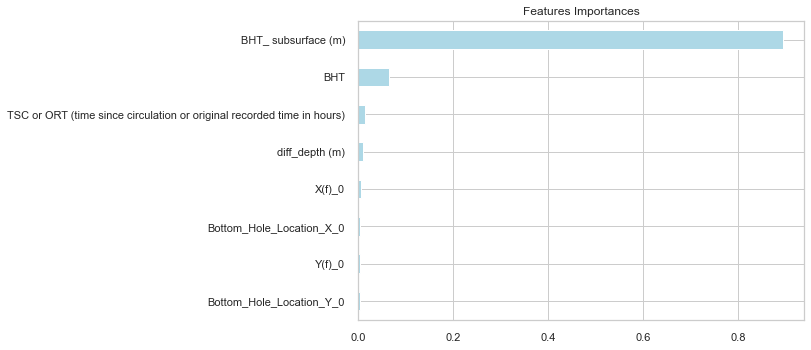

In [513]:
importancesErf_sorted.plot(kind='barh', color = 'lightblue')
plt.title ('Features Importances')
plt.show()

In [514]:
X_val = Etest_data[Efeatures]
Erfprediction = Erf.predict(X_val)
Erfprediction 

array([131.98884222, 132.84960667, 101.39777778,  95.26355556,
       113.11077778, 158.39094445, 114.06666667, 112.99072222,
       112.90005556, 110.52033334, 109.82688889, 102.03894444,
       136.09206001, 103.42833333, 123.6245    , 111.75988889,
       109.87905556, 107.84472222, 103.27533333, 110.63305556,
       112.10794444, 109.53266667, 109.69955556, 112.51655556,
       122.79883333, 108.51966667, 147.19305557,  62.613     ,
       110.30505556, 107.13394444, 112.90866667, 112.89661111,
       171.81083334, 163.14727778, 105.00666667, 104.23194444,
       106.98177778, 119.29705556, 101.13972222,  88.87083333,
       123.78166667, 112.80322222,  92.94927778, 107.1305    ,
        88.88388889,  74.68611111, 104.13644444, 104.37905556,
       133.60294889, 114.27961111, 113.68305556, 133.87369111,
       153.93461111, 165.84672222, 131.59457333, 131.19745778,
       163.79955556, 104.02622222, 113.24105556, 123.44461111,
       111.45472222, 108.18405556, 110.99105556, 121.70

## Pick EF model results

In [515]:
Etest_data['TrueTemp']=Erfprediction
Etest_data.head()

<ipython-input-515-800400224a5a>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Etest_data['TrueTemp']=Erfprediction


,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
127,12,42013339770000,113.888889,131.988842,NaN,NaN,3211.06800,11018.4,3358.40832,483.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
128,16,42013340740000,110.000000,132.849607,NaN,NaN,3151.32720,10838.4,3303.54432,499.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
129,17,42013342130000,77.222222,101.397778,NaN,NaN,2168.65200,7593.4,2314.46832,478.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
130,18,42021301990000,73.333333,95.263556,NaN,NaN,2008.02240,6928.4,2111.77632,340.4,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
131,21,42041303170000,90.000000,113.110778,NaN,NaN,2553.09624,8738.4,2663.46432,362.1,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing


### Duvernay  LR Model

In [516]:
# get target and features
Dfeatures={'BHT','BHT_ subsurface (m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1'}
#          ,'Formation DSTd', 'DST Misrun', 'Test Type'}
#,'diff_depth (m)'

X = Dtrain[Dfeatures]
y = Dtrain['TrueTemp']

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)
X_train

,SurfaceLongitude_NAD83_0.1,diff_depth (m),BHT,SurfaceLatitude_NAD83_0.1,BHT_ subsurface (m),BottomLongitude_NAD83_0.1,BottomLatitude_NAD83_0.1
127,-116.669268,-6.40,69.00,54.301584,1785.50,-116.669268,54.301584
287,-117.724145,-2.40,49.44,54.555118,1574.60,-117.724145,54.555118
355,-113.642736,-1.00,37.78,53.685307,1170.30,-113.642736,53.685307
155,-114.133423,2.80,17.10,54.289952,1023.00,-114.133423,54.289952
59,-116.770441,3.65,28.89,54.605264,1657.35,-116.770441,54.605264
...,...,...,...,...,...,...,...
256,-117.136038,9.10,43.33,54.496116,1159.60,-117.136038,54.496116
131,-116.033106,-2.75,106.11,53.531080,2449.35,-116.033106,53.531080
249,-117.439130,-1.20,63.89,54.568814,1707.80,-117.439130,54.568814
152,-116.885793,-5.15,54.44,54.361405,1703.55,-116.885793,54.361405


In [517]:
pipelines = []
pipelines.append(('StandardScalerLR', Pipeline([('Scaler', StandardScaler()),('LR',LinearRegression())])))
pipelines.append(('ScaledLASSO', Pipeline([('Scaler', StandardScaler()),('LASSO', Lasso())])))
pipelines.append(('ScaledRF', Pipeline([('Scaler', StandardScaler()),('RF', RandomForestRegressor())])))
pipelines.append(('ScaledGBM', Pipeline([('Scaler', StandardScaler()),('GBM', GradientBoostingRegressor())])))
pipelines.append(('ScaledEN', Pipeline([('Scaler', StandardScaler()),('EN', ElasticNet())])))
pipelines.append(('ScaledKNN', Pipeline([('Scaler', StandardScaler()),('KNN', KNeighborsRegressor())])))
pipelines.append(('ScaledCART', Pipeline([('Scaler', StandardScaler()),('CART', DecisionTreeRegressor())])))

results = []
names = []
for name, model in pipelines:
    kfold = KFold(n_splits=10, random_state=21, shuffle=True)
    cv_results = cross_val_score(model, X_train, y_train, cv=kfold, scoring='neg_mean_squared_error')
    results.append(cv_results)
    names.append(name)
    msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
    print(msg)

StandardScalerLR: -72.767131 (55.744422)
ScaledLASSO: -73.787081 (57.094793)
ScaledRF: -73.660002 (57.184270)
ScaledGBM: -83.776286 (57.766126)
ScaledEN: -102.044491 (40.660336)
ScaledKNN: -107.991576 (38.133865)
ScaledCART: -100.356927 (85.251369)


In [518]:
# linear regression
Dfeatures={'BHT','BHT_ subsurface (m)','Depth_SS(m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1'\
           ,'Formation DSTd','DST Misrun','Test Type'}

X = Dtrain[Dfeatures]
y = Dtrain['TrueTemp']

# create the preprocessing pipelines for both numeric and categorical data
numeric_features = ['BHT','BHT_ subsurface (m)','Depth_SS(m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1']
numeric_transformer = Pipeline(steps=[('imputer', SimpleImputer(strategy='median')),('scaler', StandardScaler())])

categorical_features = ['Formation DSTd', 'DST Misrun', 'Test Type']
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preprocessor = ColumnTransformer(remainder='passthrough', transformers=[('num', numeric_transformer, numeric_features), ('cat', categorical_transformer, categorical_features)])

lr = LinearRegression()

# Append classifier to preprocessing pipeline.
dppclr = Pipeline(steps=[('preprocessor', preprocessor), ('classifier', lr)])

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

# Model
Dlr = dppclr.fit(X_train, y_train)

print(X.columns)
print(lr.coef_)
print(lr.intercept_)

Index(['SurfaceLongitude_NAD83_0.1', 'diff_depth (m)', 'Depth_SS(m)', 'BHT',
       'Formation DSTd', 'SurfaceLatitude_NAD83_0.1', 'DST Misrun',
       'BHT_ subsurface (m)', 'BottomLongitude_NAD83_0.1',
       'BottomLatitude_NAD83_0.1', 'Test Type'],
      dtype='object')
[ 6.81654160e-01  2.48496097e+01 -1.13630778e+01  5.59925713e-01
 -2.72241765e+03 -2.09714274e+03  2.71905607e+03  2.09132527e+03
  5.09887578e+00  5.88427883e+00  4.89605895e+00  6.67874404e+00
  1.40885758e+01  5.53753019e+00  6.58909529e+00  5.36640268e+00
  9.73876679e+00  7.81986769e-01  9.41523127e+00  8.23772745e+00
  5.30426282e-01  4.23401082e+00 -7.63029064e-01  6.02630999e+00
  5.49462374e-01  8.55603525e+00  1.49748213e+00  4.57295469e+00
 -2.11138309e+00  9.59548992e+00 -2.00071910e+00 -1.82500946e+00
 -5.70244447e+00 -1.75257806e+01 -7.27128672e+00 -2.39878555e-01
 -4.81122798e+00 -3.35071448e+00 -1.77111487e+01 -1.96210980e+00
 -1.36253326e+00 -7.56488098e+00 -1.36653667e+01  1.18801307e+00
 -2.332569

In [519]:
# D train score
print('Train R2, MAE, RMSE:')
y_train_pred = Dlr.predict(X_train)
print(Dlr.score(X_train, y_train))
print(mean_absolute_error(y_train, y_train_pred))
print(np.sqrt(mean_squared_error(y_train, y_train_pred)))

# D test score
print('Test R2, MAE, RMSE:')
y_test_pred = dppclr.predict(X_test)
print(dppclr.score(X_test, y_test)) #default regression loss function is R2
print(mean_absolute_error(y_test, y_test_pred))
print(np.sqrt(mean_squared_error(y_test, y_test_pred)))

Train R2, MAE, RMSE:
0.867812449088892
3.8382313378563695
7.573680712279532
Test R2, MAE, RMSE:
0.9096052943427122
4.213012140674931
6.3712675883444625


In [520]:
X_val = Dtest_data[Dfeatures]
#X_val_pipline=dppclr(X_val)
Dlrprediction = dppclr.predict(X_val)
Dlrprediction

array([122.71242858,  49.6438994 ,  88.5371938 ,  77.4994236 ,
        85.15408504,  38.95078273,  98.98953527, 105.41598662,
        40.97665527,  51.27343832,  66.23237613,  96.84683535,
        70.68448961,  68.56699373,  85.84167602,  74.51234722,
        72.74290563,  63.64000359,  83.05671909,  64.9665546 ,
        64.84060547,  58.29031762,  63.96430154,  95.58700286,
        80.70627471, 111.41510375,  94.48098682, 107.38202904,
        57.30716674,  65.6728207 ,  55.21486038,  72.87417758,
        49.88054185,  69.76372483, 107.1691849 , 109.2644408 ,
       102.98640367,  78.875017  ,  55.71387545,  34.54172115,
        97.3420718 ,  76.21139847,  45.27446456,  96.89259655,
        90.88029428,  36.69753988,  72.7372853 ,  81.49878503,
        77.20853054,  64.14891172,  88.90787821, 116.6839632 ,
       115.40841568,  81.35912451,  54.39773287,  63.72960118,
        66.61574733,  64.79380514,  67.47890026,  65.67552664,
        71.60387706,  71.05257144,  65.46135478,  73.29

In [521]:
# claes
Dfeatures={'BHT','BHT_ subsurface (m)', 'Depth_SS(m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1'}

X = Dtrain[Dfeatures]
y = Dtrain['TrueTemp']

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.4, random_state=42)

scaler = StandardScaler().fit(X_train)
rescaledX = scaler.transform(X_train)
param_grid = dict(n_estimators=np.array([25,50,75,100,125,150]))
model = GradientBoostingRegressor(random_state=21)
kfold = KFold(n_splits=10, random_state=21, shuffle=True)
grid = GridSearchCV(estimator=model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=kfold)
grid_result = grid.fit(rescaledX, y_train)

means = grid_result.cv_results_['mean_test_score']
stds = grid_result.cv_results_['std_test_score']
params = grid_result.cv_results_['params']
for mean, stdev, param in zip(means, stds, params):
    print("%f (%f) with: %r" % (mean, stdev, param))

print("Best: %f using %s" % (grid_result.best_score_, grid_result.best_params_))

-81.425771 (70.156620) with: {'n_estimators': 25}
-72.113741 (62.727018) with: {'n_estimators': 50}
-71.683688 (60.170667) with: {'n_estimators': 75}
-72.741367 (60.261958) with: {'n_estimators': 100}
-73.999108 (60.258474) with: {'n_estimators': 125}
-74.634434 (59.673212) with: {'n_estimators': 150}
Best: -71.683688 using {'n_estimators': 75}


In [522]:
from sklearn.metrics import mean_squared_error
from sklearn.metrics import mean_absolute_error as mae

scaler = StandardScaler().fit(X_train)
rescaled_X_train = scaler.transform(X_train)
model = GradientBoostingRegressor(random_state=21, n_estimators=75)
model.fit(rescaled_X_train, y_train)

# transform the validation dataset
rescaled_X_test = scaler.transform(X_test)
predictions = model.predict(rescaled_X_test)
print (mean_squared_error(y_test, predictions))
print (mae(y_test, predictions))

79.89841021977824
5.145409180444978


In [523]:
# Lasso
Dfeatures={'BHT','BHT_ subsurface (m)','Depth_SS(m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1'\
           ,'Formation DSTd','DST Misrun','Test Type'}

X = Dtrain[Dfeatures]
y = Dtrain['TrueTemp']

# create the preprocessing pipelines for both numeric and categorical data
numeric_features = ['BHT','BHT_ subsurface (m)','Depth_SS(m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = ['Formation DSTd', 'DST Misrun', 'Test Type']
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preprocessor = ColumnTransformer(remainder='passthrough', #passthough features not listed
        transformers=[
        ('num', numeric_transformer, numeric_features), ('cat', categorical_transformer, categorical_features)])

ls = Lasso()

# Append classifier to preprocessing pipeline.
dppcls = Pipeline(steps=[('preprocessor', preprocessor), ('classifier', ls)])

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

# Model
Dls = dppcls.fit(X_train, y_train)

In [524]:
# D train score
print('Train R2, MAE, RMSE:')
y_train_pred = Dls.predict(X_train)
print(Dls.score(X_train, y_train))
print(mean_absolute_error(y_train, y_train_pred))
print(np.sqrt(mean_squared_error(y_train, y_train_pred)))

# D test score
print('Test R2, MAE, RMSE:')
y_test_pred = Dls.predict(X_test)
print(Dls.score(X_test, y_test)) #default regression loss function is R2
print(mean_absolute_error(y_test, y_test_pred))
print(np.sqrt(mean_squared_error(y_test, y_test_pred)))

Train R2, MAE, RMSE:
0.8339832340069204
4.630444823230455
8.487654426056503
Test R2, MAE, RMSE:
0.9053031531999595
4.054725939139003
6.521118724495737


In [525]:
X_val = Dtest_data[Dfeatures]
Dlsprediction = dppcls.predict(X_val)
Dlsprediction

array([117.94454577,  54.87595898,  90.17681649,  81.81911545,
        85.32119344,  48.68864705,  98.45772444, 105.09308405,
        47.93706242,  58.66592317,  68.57766549,  92.68879381,
        71.73594202,  69.55917081,  79.86648186,  74.32134782,
        72.31443954,  66.80532047,  80.68962501,  63.63810854,
        67.24550816,  58.40052822,  66.56889153,  95.35972034,
        82.42208004, 109.54118418,  84.7477052 , 111.53180911,
        55.79437891,  66.78313753,  56.71132763,  71.27339622,
        48.13306657,  71.88930839, 107.44505718, 110.19046019,
       103.90406254,  80.0897108 ,  54.42370427,  47.41944742,
        96.73722787,  75.38736053,  52.54695804,  95.03651724,
        94.38488823,  41.60063641,  73.25606426,  77.52470994,
        76.39607047,  67.49599947,  89.62288126, 123.65674199,
       116.21215166,  78.21809045,  47.63275238,  66.68151726,
        68.23146331,  67.77670047,  69.66277712,  67.32305537,
        67.7500004 ,  70.9087262 ,  67.15542513,  67.78

In [526]:
# Random Forest
Dfeatures={'BHT','BHT_ subsurface (m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1'\
           ,'Formation DSTd','DST Misrun','Test Type'}

X = Dtrain[Dfeatures]
y = Dtrain['TrueTemp']

# create the preprocessing pipelines for both numeric and categorical data
numeric_features = ['BHT','BHT_ subsurface (m)','diff_depth (m)'\
           ,'SurfaceLatitude_NAD83_0.1','SurfaceLongitude_NAD83_0.1'\
           ,'BottomLatitude_NAD83_0.1','BottomLongitude_NAD83_0.1']
numeric_transformer = Pipeline(steps=[
    ('imputer', SimpleImputer(strategy='median')),
    ('scaler', StandardScaler())])

categorical_features = ['Formation DSTd', 'DST Misrun', 'Test Type']
categorical_transformer = OneHotEncoder(handle_unknown='ignore')

preprocessor = ColumnTransformer(transformers=[
        ('num', numeric_transformer, numeric_features),
        ('cat', categorical_transformer, categorical_features)])

# Append classifier to preprocessing pipeline.
dppcrf = Pipeline(steps=[('preprocessor', preprocessor), ('classifier', RandomForestRegressor())])
# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)
                  

drf = RandomForestRegressor()

# train test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=3)

# Model
Drf = dppcrf.fit(X_train, y_train)

In [527]:
# D train score
print('Train R2, MAE, RMSE:')
y_train_pred = Drf.predict(X_train)
print(Drf.score(X_train, y_train))
print(mean_absolute_error(y_train, y_train_pred))
print(np.sqrt(mean_squared_error(y_train, y_train_pred)))

# D test score
print('Test R2, MAE, RMSE:')
y_test_pred = Drf.predict(X_test)
print(Drf.score(X_test, y_test)) #default regression loss function is R2
print(mean_absolute_error(y_test, y_test_pred))
print(np.sqrt(mean_squared_error(y_test, y_test_pred)))

Train R2, MAE, RMSE:
0.9755835190325106
1.7983758632898674
3.2550169158426847
Test R2, MAE, RMSE:
0.9088779277051683
3.7898157653743243
6.396849630610475


In [528]:
X_val = Dtest_data[Dfeatures]
Drfprediction = Drf.predict(X_val)
Drfprediction 

array([118.0911    ,  52.2705    ,  93.663     ,  83.144     ,
        87.32931111,  42.40455555,  98.05654444, 105.2464    ,
        41.05234444,  54.9559    ,  65.8544    ,  99.7008    ,
        71.88955556,  67.8093    ,  79.9751    ,  74.6777    ,
        72.1671    ,  65.89108889,  85.01686667,  63.67388889,
        65.49178889,  52.5252    ,  64.7586    ,  96.96523333,
        83.2731    , 109.7704    ,  85.35771111, 108.145     ,
        51.9383    ,  63.9688    ,  53.2414    ,  71.9102    ,
        42.29332222,  71.7489    , 104.4815    , 106.2269    ,
       104.2252    ,  80.1582    ,  52.61352222,  38.80322222,
        99.4787    ,  76.0495    ,  51.73462222,  99.7203    ,
        99.0233    ,  32.4154    ,  73.1937    ,  78.4499    ,
        76.7811    ,  65.04148889,  94.48764444, 121.1412    ,
       117.2621    ,  86.7321    ,  41.38628889,  65.65451111,
        65.9539    ,  68.55746667,  65.5953    ,  66.0151    ,
        69.71771111,  67.93084444,  66.9964    ,  64.95

## 9.2 Pick Duvernay model

In [529]:
Dtest_data['TrueTemp']=Drfprediction
Dtest_data.head()

<ipython-input-529-1a74afaaecde>:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Dtest_data['TrueTemp']=Drfprediction


,Unnamed: 0_x,UWI,BHT,TrueTemp,deltaT,Depth sub-sea (feet),Depth_SS(m),BHT_ subsurface (ft),BHT_ subsurface (m),GL(ft),...,21600.0_GRWS,21900.0_GRWS,22200.0_GRWS,22500.0_GRWS,22800.0_GRWS,23100.0_GRWS,23400.0_GRWS,23700.0_GRWS,24000.0_GRWS,Set
0,8,100012404516W502,93.33,118.091100,NaN,7654.527559,2333.10,11860.564304,3615.10,4206.036745,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
1,10,100012805703W500,37.00,52.270500,NaN,1749.343832,533.20,4058.398950,1237.00,2309.055118,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
2,16,100020206419W500,82.22,93.663000,NaN,5717.847769,1742.80,8191.929134,2496.90,2474.081365,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
3,19,100020605904W500,78.89,83.144000,NaN,5226.870079,1593.15,7367.946194,2245.75,2141.076115,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing
4,20,100020606216W500,77.22,87.329311,NaN,4630.413386,1411.35,7622.539370,2323.35,2992.125984,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,Validation_Testing


In [530]:
Etest_data.index += len(Dtest_data)

In [531]:
CombineValData = pd.concat((Dtest_data[['UWI', 'TrueTemp']], Etest_data[['UWI', 'TrueTemp']] ))

In [532]:
CombineValData.head()

,UWI,TrueTemp
0,100012404516W502,118.091100
1,100012805703W500,52.270500
2,100020206419W500,93.663000
3,100020605904W500,83.144000
4,100020606216W500,87.329311


In [533]:
CombineValData.tail()

,UWI,TrueTemp
328,42493306840000,111.431167
329,42493311060000,76.121944
330,42493311680000,89.049889
331,42493322270000,89.603500
332,42507312420000,66.692722


In [534]:
CombineValData.to_csv('predictions.csv')

In [535]:
import zipfile
zipfile.ZipFile('predictions.zip', mode='w').write("predictions.csv")